# Análisis

Este documento explora correlaciones entre los componentes de pilares de iEcosystems, tales como 

* I-Funding
* E-Funding
* Comparative Advantage
* Impact

Así como sus relaciones con métricas globales de los ecosistemas, como aquellas métricas que describen la 

* estabilidad
* robustez
* propensión al colapso



In [2]:
#Paquetes que utilizaremos

import numpy as np 
import pandas as pd 
import matplotlib as plt

import scipy.stats as stats

In [3]:
def significant_corr(df1,df2,a,b):
    '''
    This function computed the pearson correlation between two data sets a, b, 
    and determines whether this correlation is significant or not. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - b    : a data vector
    
    Output : a tuple (B,N) where B is a boolean that answers the question:
    ~do a and b present significant correlation? i.e. p-value<0.1,
    and N=0 is B=False, or N=p-val(a,b) if B=True
    '''
    if df2.empty:
        df2=df1
    r = stats.pearsonr(df1[a], df2[b])
    if r[1] < 0.1:
        return (True,r[0])
    else:
        return (False,0)
    
    
    

def print_significant_corr(df1,df2,a,b):
    '''
    This function computes the Pearson correlation between two data sets a, b, 
    and prints whether this correlation is significant or not, and the 
    corresponding Pearson correlation and p-value. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - b    : a data vector
    
    Output : None, but executes print statements showing the findings about aand b.
    '''
    if df2.empty:
        df2=df1
    r = stats.pearsonr(df1[a], df2[b])
    if r[1] < 0.1:
        print(f'Correlation between:  ' + a + '   and   ' + b)
        print('**********************************************')
        print(f'Pearson Correlation: {r[0]}, p-value: {r[1]}')
        print('*Statistically significant*')
        print('***********************************************')

## Carga de Datos

En la siguiente viñeta conseguimos los siguientes DataFrames, con base en los cuales vamos a realizar nustro análisis.

In [4]:
#Medidas de iEcosystems, con promedios por pilar
df_means = pd.read_csv('PromediosPilares.csv')

grf_df = pd.read_csv('Tidy_DataFrame.csv')

ieco_grf_df = pd.read_csv('iEco_with_Graph_metrics.csv')

grf_sin_islas_nd = pd.read_csv('Gephi_sin_islas/CABA sin islas nodes.csv')
full_ieco_df = pd.read_csv('Kevin/full_iEco.csv')

full_ieco_df = full_ieco_df.rename({0:1,1:0,5:3,3:5},axis='index')
full_ieco_grf_df = pd.concat([full_ieco_df,grf_df],axis=1)


In [24]:
#DataFrame en el cual se muestra, por capital, el valor de cada uno de los pilares de iEcosystems.
# Copia del DataFrame antetior, solo que 
# Mexico->1, 
# Arg->0, 
# Chile ->2, 
# Bra->5, 
# España->4, 
# Uruguay-3

df_means

,Unnamed: 0,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,3.05 E-Culture & Incentives,4 Comparative Advantage,5 Impact
0,México,3.522,2.278000,1.5600,3.3175,3.110000,2.515,3.115,2.300000,3.6275,3.430,2.970000,2.93,3.725455
1,Argentina,3.169,2.034667,1.7400,3.3100,2.716667,1.795,3.075,1.723333,3.7125,3.175,2.965000,2.58,3.781818
2,Chile,3.913,2.580667,1.2025,3.6925,2.960000,1.955,4.155,2.206667,3.9975,3.205,3.455000,3.11,4.091818
3,Brasil,3.177,1.828000,1.8400,3.2650,2.876667,2.755,2.975,1.991667,3.6775,3.460,3.438333,2.74,3.671818
4,España,3.929,2.992000,1.9500,3.9525,3.076667,3.830,3.190,2.423333,4.2925,3.365,2.626667,2.84,3.864545
5,Uruguay,3.780,2.171333,1.5025,3.6150,2.570000,1.245,3.045,2.005000,3.9050,2.740,3.143333,2.48,4.147576


In [6]:
#DataFrame en el cual se muestra, por capital, el valor de una colección
#de métricas globales observadas en nuestros ecosistemas

grf_df

,Ciudad,País,avg strength,weight,Degree,Weighted Degree,Eccentricidad,Clustering,Diámetro,Radio,Camino más corto promedio,Transitividad,Eficiencia Global,Small Worldness,Core Ratio,Central Point Dominance,Spectral radius
0,CABA,Argentina,3.244633,1.481579,4.385965,14.017544,4.798246,0.148791,6,3,3.355669,0.107392,0.325773,0.960807,0.495614,0.251,1.868
1,CDMX,México,3.477388,1.388629,3.658863,12.963211,5.622074,0.075940,7,4,3.820318,0.050000,0.289320,0.677149,0.421405,0.202,1.910
2,Santiago de Chile,Chile,3.417211,1.462564,3.948718,13.764103,5.041026,0.134037,6,3,3.227544,0.100744,0.338889,0.906814,0.430769,0.525,1.890
3,Montevideo,Uruguay,3.227742,2.749495,7.747475,25.939394,4.479798,0.207747,6,3,3.081116,0.224523,0.360837,1.274519,0.565657,0.179,1.778
4,Madrid,España,3.518387,1.362343,3.790795,12.861925,6.079498,0.120510,8,5,3.783517,0.081917,0.294653,1.141033,0.439331,0.184,1.920
5,Sao Paulo,Brasil,3.430669,1.253704,3.370370,11.694444,6.726852,0.129928,8,4,4.324031,0.078571,0.266719,1.211794,0.421296,0.237,1.983


In [7]:
#DataFrame en el cual se muestra, por capital, el valor de 
# las métricas de iEcosystems junto con las métricas
# globales observadas en nuestros ecosistemas.

ieco_grf_df

,Unnamed: 0,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,...,Clustering,Diámetro,Radio,Camino más corto promedio,Transitividad,Eficiencia Global,Small Worldness,Core Ratio,Central Point Dominance,Spectral radius
0,México,3.522,2.278000,1.5600,3.3175,3.110000,2.515,3.115,2.300000,3.6275,...,0.075940,7,4,3.820318,0.050000,0.289320,0.677149,0.421405,0.202,1.910
1,Argentina,3.169,2.034667,1.7400,3.3100,2.716667,1.795,3.075,1.723333,3.7125,...,0.148791,6,3,3.355669,0.107392,0.325773,0.960807,0.495614,0.251,1.868
2,Chile,3.913,2.580667,1.2025,3.6925,2.960000,1.955,4.155,2.206667,3.9975,...,0.134037,6,3,3.227544,0.100744,0.338889,0.906814,0.430769,0.525,1.890
3,Brasil,3.177,1.828000,1.8400,3.2650,2.876667,2.755,2.975,1.991667,3.6775,...,0.129928,8,4,4.324031,0.078571,0.266719,1.211794,0.421296,0.237,1.983
4,España,3.929,2.992000,1.9500,3.9525,3.076667,3.830,3.190,2.423333,4.2925,...,0.120510,8,5,3.783517,0.081917,0.294653,1.141033,0.439331,0.184,1.920
5,Uruguay,3.780,2.171333,1.5025,3.6150,2.570000,1.245,3.045,2.005000,3.9050,...,0.207747,6,3,3.081116,0.224523,0.360837,1.274519,0.565657,0.179,1.778


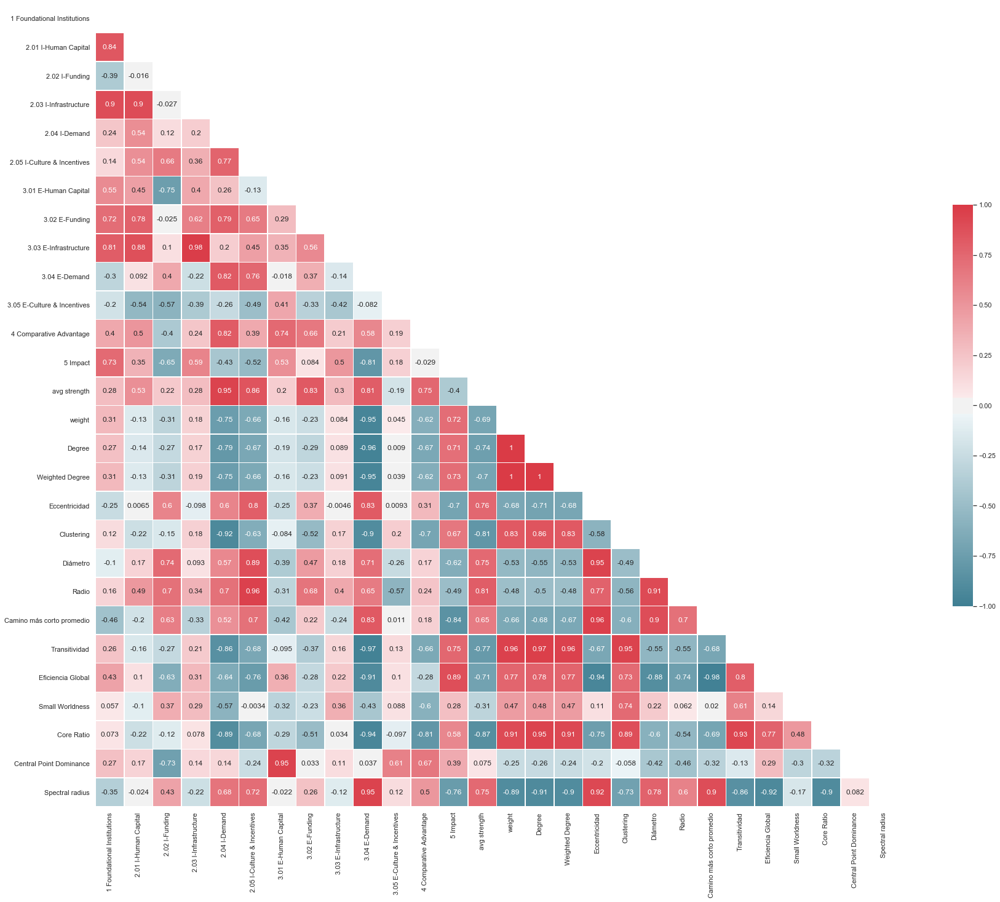

In [8]:
ieco_global_corr_df = ieco_grf_df.corr()
pd.set_option("display.max_rows", None, "display.max_columns", None)
#ieco_global_corr_df

import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(ieco_global_corr_df, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(32, 24))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(ieco_global_corr_df, mask=mask, cmap=cmap, annot=True, vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [9]:
#DataFrame en el cual se muestra, por capital, el valor de 
# las métricas de iEcosystems desglosadas en sus componentes.

full_ieco_df

,Unnamed: 0,1.01 Ease of doing business (WB),1.02 Starting a business (WB),1.03 Paying taxes (WB),1.04 Resolving Insolvency (WB),1.05 Enforcing contracts (WB),1.06 Property Rights (IEF),1.07 Government Integrity (IEF),1.08 Labor Freedom (IEF),1.09 Trade freedom (IEF),1.10 Corruption Perceptions Index (TI),2.01a Percentage of adults with a doctoral or equivalent level of education (OECD),2.01b Skillset of graduates (GCI 4.0),2.01c Ease of finding skilled employees (GCI 4.0),2.01d Researchers/Professionals engaged in R&D per million population (GII),"2.01e STEM Graduates per capita (OECD) - Natural sciences, mathematics and statistics",2.02a R&D expenditure as a % GDP (UNESCO),2.02b R&D expenditure in '000 current PPP$ (UNESCO),2.02c Public R&D Expenditure as % of total R&D expenditure (UNESCO),2.02d Business Expenditure as % of total R&D expenditure (UNESCO),2.03a ICT Adoption (GCI 4.0),2.03b Production Process Sophistication (GCI),2.03c Availability of latest technologies (GCI),2.03d ICT access (GII),2.04a Government procurement of advanced technology (GCI),2.04b University-industry research collaborations (GII),"2.04c Trade, Competition & Market scale (GII)",2.05a Research institutions prominence (GCI 4.0),2.05b Graduates in science & engineering (%) (GII),3.01a Entrepreneurship perceived capabilities (GEM),3.01b % school grads in tertiary education (GII),3.02a VC investment,3.02b Financing of SME's (GCI 4.0),3.02c Venture Capital Availability (GCI 4.0),3.02d Ease of Credit (GII),3.02e VC deals (GII),3.02f Venture Capital Deal Volume,3.03a Logistics performance (World Bank),3.03b Electricity (GCI),3.03c ICT Adoption (GCI),3.03d Number of internet users (UN),3.04a Buyer sophistication (GCI 4.0),3.04b Domestic Market Scale (GII),3.05a Entrepreneurial intentions (GEM),3.05b Fear of failure (GEM),3.05c Entrepreneurship as a Good Career choice (GEM),3.05d High Status to Successful Entrepreneurs (GEM),3.05e Business Freedom (Heritage Foundation),3.05f Attitudes towards Entrepreneurial Risk (GCI 4.0),4.01 State of cluster development (GCI 4.0),4.02 Country capacity to attract and retain talent,5.01 GDP per capita,5.02 Social Progress Index,5.03 Inclusive Development Index,5.04 Population below international poverty line (SDG 1 - No poverty),5.05 Prevalence of undernourishment (SDG 2 - Zero Hunger),5.06 Annual growth rate of real GDP per capita (SDG 8 - Decent Jobs and Economic Growth),5.07 Unemployment rate of population 15 years of age and older (SDG 8 - Decent Jobs and Economic Growth),"5.08 Carbon dioxide emissions per unit of GDP (SDG 9 - Industry, Innovation and Infrastructure)",5.09 Proportion of urban population living in slums (SDG 11 - Sustainable Cities and Communities),5.10 Annual population-weighted average mean concentration of fine suspended particles of less than 2.5 microns in diameter (SDG 11 - Sustainable Cities and Communities),5.11 Domestic material consumption per capita (SDG 12 - Responsible Consumption and Production)
1,México,3.90,4.44,3.63,3.81,3.68,3.33,2.47,3.34,4.50,2.12,1.000000,3.06,3.12,1.11,3.100000,1.41,1.09,2.58,1.16,3.20,3.20,3.67,3.20,2.40,2.75,4.18,2.19,2.84,4.04,2.19,1.52,2.82,2.53,4.6,1.04,1.29,3.08,4.82,3.20,3.41,2.76,4.10,1.78,2.21,3.49,3.62,3.68,3.04,3.19,2.67,1.46,3.82,3.08,4.80,4.88,3.34,4.72,4.33,4.520000,4.32,1.71
0,Argentina,3.36,4.22,2.97,2.60,3.30,3.02,2.99,2.86,3.77,2.60,1.343333,3.12,3.12,1.59,1.000000,1.45,1.04,3.33,1.14,3.32,2.87,3.13,3.92,2.20,2.50,3.45,1.79,1.80,2.34,3.81,1.08,2.08,1.88,3.2,1.08,1.02,2.93,4.79,3.32,3.81,2.66,3.69,1.67,4.06,2.99,2.63,3.41,3.03,2.63,2.53,1.55,4.07,3.09,4.97,4.88,3.58,3.94,4.20,4.580000,4.71,2.03
2,Chile,3.90,4.66,4.01,3.40,3.59,3.80,3.94,3.59,4.56,3.68,1.343333,3.39,3.58,1.24,3.350000,1.29,1.01,1.37,1.14,3.52,3.27,4.07,3.91,2.20,2.75,3.93,1.63,2.28,4.42,3.89,1.88,3.09,2.84,3.2,1.12,1.11,3.28,5.00,3.52,4.19,2.98,3.43,4.71,1.00,3.85,4.01,4.00,3.16,2.82,3.40,1.76,4.20,3.29,4.94,4.93,3.32,4.16,4.29,4.840000,4.28,5.00
5,Brasil,3.36,4.25,2.38,3.02,3.56,

In [10]:
#------------------
# Exploración 1
#------------------

list1=list(df_means.keys())     #Pilares de iEcosystems
list2=list(grf_df.keys())      #Nombres de métricas globales

list1.remove('Unnamed: 0')     #Removemos columnas que no denotan valores numéricos
list2.remove('Ciudad')
list2.remove('País')

positive_pairs=[]
negative_pairs=[]

for key1 in list1:             #por cada métrica de iEco y global del grafo, revisamos si hay corr. significativa
    for key2 in list2:
        sig,corr=significant_corr(ieco_grf_df,ieco_grf_df,key1,key2)
        if sig==True:
            if corr>0:
                positive_pairs.append((key1,key2))                             #si correlación significativa y >0
            else:
                negative_pairs.append((key1,key2))                             #si correlación significativa y <=0

In [11]:
#El texto impreso es una lista de correlaciones significativas y positivas que encontramos (+)

for keys in positive_pairs:
    print('')
    print_significant_corr(ieco_grf_df,ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.02 I-Funding   and   Diámetro
**********************************************
Pearson Correlation: 0.7385065695777545, p-value: 0.09362791589032411
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   avg strength
**********************************************
Pearson Correlation: 0.952116314101418, p-value: 0.00338437607108655
*Statistically significant*
***********************************************


Correlation between:  2.05 I-Culture & Incentives   and   avg strength
**********************************************
Pearson Correlation: 0.857666917638727, p-value: 0.028946317443073532
*Statistically significant*
***********************************************


Correlation between:  2.05 I-Culture & Incentives   and   Eccentricidad
**********************************************
Pearson Correlation: 0.8042285278880069, p-value: 0.05373808928218256
*Statistically significant*
****************

In [12]:
#El texto impreso es una lista de correlaciones significativas y negativas que encontramos (-)

for keys in negative_pairs:
    print('')
    print_significant_corr(ieco_grf_df,ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.04 I-Demand   and   weight
**********************************************
Pearson Correlation: -0.7513026741395321, p-value: 0.08508453028112797
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Degree
**********************************************
Pearson Correlation: -0.7930354359599853, p-value: 0.059818901855709296
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Weighted Degree
**********************************************
Pearson Correlation: -0.7540324234088823, p-value: 0.08330954791577455
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Clustering
**********************************************
Pearson Correlation: -0.9174944429171863, p-value: 0.009929935873654164
*Statistically significant*
**********************************************

In [13]:
#------------------
# Exploración 2
#------------------

#list1=list(full_ieco_df.keys())
list1=['2.04a Government procurement of advanced technology (GCI)',
       '2.04b University-industry research collaborations (GII)',
       '2.04c Trade, Competition & Market scale (GII)',
       '3.04a Buyer sophistication (GCI 4.0)',
       '3.04b Domestic Market Scale (GII)']                           #lista: componentes de I-Demand
list2=list(grf_df.keys())                                             #lista: métricas globales

list2.remove('Ciudad')   #removemos columnas con valores que no son numéricos
list2.remove('País')

positive_pairs_2=[]
negative_pairs_2=[]

for key1 in list1:                     #por cada componente de IDemand, métrica global revisamos corr. significativa
    for key2 in list2:                 
        sig,corr = significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)
        if sig == True:
            if corr > 0:
                positive_pairs_2.append((key1,key2))        #correlación significativa positiva
            else:
                negative_pairs_2.append((key1,key2))        #correlación significativa negativa

In [14]:
#El texto impreso es una lista de correlaciones significativas y positivas que encontramos (+)

for keys in positive_pairs_2:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.04b University-industry research collaborations (GII)   and   avg strength
**********************************************
Pearson Correlation: 0.9057240787070973, p-value: 0.012912964197428016
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Spectral radius
**********************************************
Pearson Correlation: 0.7928267560324674, p-value: 0.059935113706115976
*Statistically significant*
***********************************************


Correlation between:  2.04c Trade, Competition & Market scale (GII)   and   avg strength
**********************************************
Pearson Correlation: 0.9567036039358547, p-value: 0.0027712856343463715
*Statistically significant*
***********************************************


Correlation between:  2.04c Trade, Competition & Market scale (GII)   and   Spectral radius
****************************

In [15]:
#El texto impreso es una lista de correlaciones significativas y negativas que encontramos (-)

for keys in negative_pairs_2:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.04b University-industry research collaborations (GII)   and   weight
**********************************************
Pearson Correlation: -0.8026827654539166, p-value: 0.05455995298570256
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Degree
**********************************************
Pearson Correlation: -0.8537047923796843, p-value: 0.03053790559238056
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Weighted Degree
**********************************************
Pearson Correlation: -0.8072291739267888, p-value: 0.05215914812809959
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Clustering
**************************

In [16]:
#------------------
# Exploración 3
#------------------

list1=list(full_ieco_df.keys())[-9:]                #lista de componentes del indicador Impacto
list2=list(grf_df.keys())                           #lista de métricas globales

list2.remove('Ciudad')    #removemos parámetros con valores no numéricos
list2.remove('País')

positive_pairs_3=[]
negative_pairs_3=[]

for key1 in list1:                                  #revisamos en cada pareja si hay corr. significativa + o -
    for key2 in list2:
        sig,corr=significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)
        if sig==True:
            if corr>0:
                positive_pairs_3.append((key1,key2))
            else:
                negative_pairs_3.append((key1,key2))

In [17]:
#El texto impreso es una lista de correlaciones significativas y positivas que encontramos (+)

for keys in positive_pairs_3:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  5.03 Inclusive Development Index   and   Eficiencia Global
**********************************************
Pearson Correlation: 0.7507052737497485, p-value: 0.08547522386457787
*Statistically significant*
***********************************************


Correlation between:  5.04 Population below international poverty line (SDG 1 - No poverty)   and   Eficiencia Global
**********************************************
Pearson Correlation: 0.8524436013503677, p-value: 0.031052971497648834
*Statistically significant*
***********************************************


Correlation between:  5.05 Prevalence of undernourishment (SDG 2 - Zero Hunger)   and   Small Worldness
**********************************************
Pearson Correlation: 0.8859378118403944, p-value: 0.0187732891942125
*Statistically significant*
***********************************************


Correlation between:  5.08 Carbon dioxide emissions per unit of GDP (SDG 9 - Industry, Innovation and Infrastru

In [18]:
#El texto impreso es una lista de correlaciones significativas y negativas que encontramos (-)

for keys in positive_pairs_3:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')


Correlation between:  5.03 Inclusive Development Index   and   Eficiencia Global
**********************************************
Pearson Correlation: 0.7507052737497485, p-value: 0.08547522386457787
*Statistically significant*
***********************************************


Correlation between:  5.04 Population below international poverty line (SDG 1 - No poverty)   and   Eficiencia Global
**********************************************
Pearson Correlation: 0.8524436013503677, p-value: 0.031052971497648834
*Statistically significant*
***********************************************


Correlation between:  5.05 Prevalence of undernourishment (SDG 2 - Zero Hunger)   and   Small Worldness
**********************************************
Pearson Correlation: 0.8859378118403944, p-value: 0.0187732891942125
*Statistically significant*
***********************************************


Correlation between:  5.08 Carbon dioxide emissions per unit of GDP (SDG 9 - Industry, Innovation and Infrastru

In [19]:
from sklearn.linear_model import LinearRegression
from scipy import stats
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d



def lin_reg_p_val(reg,X,y):
    '''
    Esta función busca el p-value entre
    
    - X : np.array
    - y : vector de datos
    
    Es decir, mide la correlación entre un conjunto de puntos X 
    determinado por una pareja de variables y un cnjunto de valores y.
    
    Inputs : specified above
    Output : p-value(X,y)
    '''
    
    # predice el np.array X usando modelo lineal, y suma las distancias al cuadrado de esa predicción hacia y
    # luego divide entre  (X.shape[0] - X.shape[1])= (no.columnas, no.filas)
    sse = np.sum((reg.predict(X) - y) ** 2, axis=0) / float(X.shape[0] - X.shape[1])
    
    if isinstance(sse, float):  
        
        # si sse es un valor decimal, entonces forma se, una matriz (np.array) que al cuadrado
        # es igual a diag( sse * (X^T * X)^-1 ) 
        
        se = np.array([np.sqrt(np.diagonal(sse * np.linalg.inv(np.dot(X.T, X))))])  
        
    else: 
        # si sse no es un valor decimal sino un np.array, entonces se forma se, una lista tal que
        # por cada columna i, el valor se[i]^2 = diag( sse[i] * (X^T * X)^-1 ) 
        
        se = np.array([np.sqrt(np.diagonal(sse[i] * np.linalg.inv(np.dot(X.T, X)))) for i in range(sse.shape[0])])
    
    # con estos dos últimas líneas, obtiene el p-value entre 
    # el conjunto de valores X y el conjunto de valores y
    t = reg.coef_ / se
    p = 2 * (1 - stats.t.cdf(np.abs(t), y.shape[0] - X.shape[1]))
    return p

def plot_linear_model(reg,X,y,key1,key2,predict):
    '''
    This function plots the linear modeling of a vector of variables y in terms of 
    a set of points X, determined by 2 data vectors. 
    
    Inputs:
    - reg :     regression model 
    - X :       a set of points representing some data vectors.
    - y :       data which is to be predicted from the other data vectors
    - key1 :    sring for axis label -> predicting data
    - key2 :    sring for axis label -> predicting data
    - predict : string for axis label -> predicted data
    
    Outputs: 
    None, and a ~very nice~ 3D plot showing how good 
    data collection X might be in predicting linearly data vector y.
    '''
    
    ax = plt.axes(projection='3d')      #we are about to do a 3D projection
    plt.tight_layout()
    
    a = np.linspace(1, 5, 30)         
    b = np.linspace(1, 5, 30)
    
    A,B = np.meshgrid(a,b)              #we form a grid based on a (30 equidistant values from 1 to 5) and b (x2)
    C = A*reg.coef_[0] + B*reg.coef_[1] + reg.intercept_   # plane which depicts the linear approximation of y by X
    
    
    ax.scatter3D(X[:,0], X[:,1], y, cmap='Greens')         # we scatter X information in Green
    ax.contour3D(A, B, C, 50, cmap='binary')               # we plot the 3D contour of the linear approximation
    
    
    ax.set_title('Linear Model')                           # Title of plot
    ax.set_xlabel(key1, fontsize=9)                                    # Coordinates labeling
    ax.set_ylabel(key2, fontsize=9)
    ax.set_zlabel(predict, fontsize=9)
    plt.xlim((1,5))
    plt.ylim((1,5))
    plt.show()                                             #pull down the curtains!

In [20]:
''' 
4d linear model
Has too many responses and is likely not useful. 
Didn't try higher dimensions because it was likely to happen the same (any n+1 points are in an n-plane)
'''

ieco_key_list=list(df_means.keys())
ieco_key_list.remove('Unnamed: 0')
ieco_key_list.remove('4 Comparative Advantage')
ieco_key_list.remove('5 Impact')                        #list of ieco pilars without 4: C.Advantage ,5: Impact


ieco_key_predictors=['4 Comparative Advantage','5 Impact']     #ieco data we want to use to predict


grf_key_list=list(grf_df.keys())                        #list of graph global metrics 
grf_key_list.remove('Ciudad')
grf_key_list.remove('País')


for key1 in ieco_key_list:     
    for key2 in ieco_key_list:
        if key1 != key2:
            for key3 in ieco_key_list:
                if key3 !=key1 and key3 !=key2:         # for every (a,b,c) different ieco metrics
                    
                    for predict in ieco_key_predictors: 
                        X=np.concatenate([ieco_df[key1].to_numpy(),ieco_df[key2].to_numpy(),ieco_df[key3].to_numpy()],axis=0)
                        X=X.reshape(6,3)
                        y=ieco_df[predict].to_numpy()
                        reg=LinearRegression().fit(X,y)
                        p=lin_reg_p_val(reg,X,y)
                        if p[0][0]<.05 and p[0][1]<.05 and p[0][2]<.05 and reg.score(X,y)>.9:
                            print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                            print('Predictor metrics: '+key1+', '+key2+', '+key3)
                            print('Predicted: '+predict)
                            print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                            print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                            print('Regression Coefficients: ' + str(reg.coef_) )
                            print('')
                            print('')
                            print('')


NameError: name 'ieco_df' is not defined

In [21]:
'''
3D linear model for predicting impact and comparative advantage from iEcosystem metrics
'''

for key1 in ieco_key_list:                         # for each pair (a,b) of distinct ieco metrics
    for key2 in ieco_key_list:
        if key1 != key2:
            for predict in ieco_key_predictors:    #or each predictor from Impact and C. Advantage
                
                #we make a numpy array from the predicted values and reshape it into 2 rows, 6 columns
                X=np.concatenate([ieco_df[key1].to_numpy(),ieco_df[key2].to_numpy()],axis=0)
                X=X.reshape(6,2)
                
                #make a numpy array of predictor
                y=ieco_df[predict].to_numpy()
                
                #make a Linear regression and obtains p-value using previously defined function
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if both p-values are small enough and the linear regression score is greater than 0.8
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')

NameError: name 'ieco_df' is not defined

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8655526062772128, p-value: [[0.00806769 0.00845523]]
Regression Coefficients: [ 1.72874085 -1.79178788]
Intercept: 2.7871861116888463


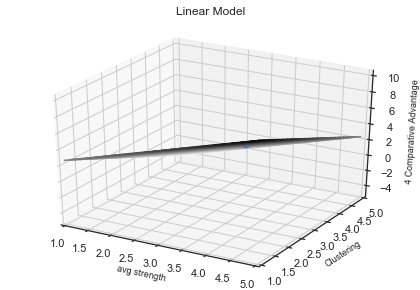




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9614385297472103, p-value: [[0.00060939 0.00063759]]
Regression Coefficients: [ 1.71486568 -1.78025141]
Intercept: 2.797470664186466


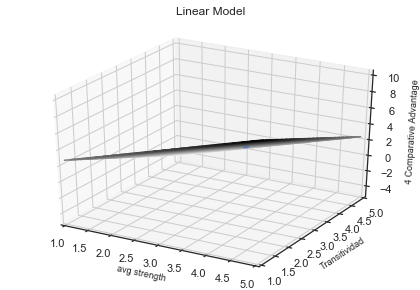




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026624487127016, p-value: [[0.00509078 0.00558599]]
Regression Coefficients: [ 1.70507095 -1.74548288]
Intercept: 2.7168644705934555


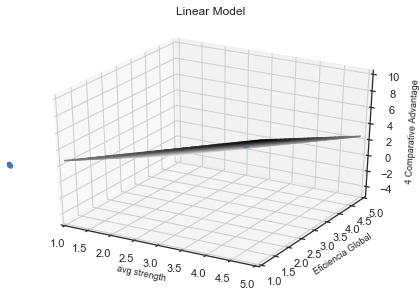




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.928705965938175, p-value: [[0.00171129 0.00172726]]
Regression Coefficients: [ 1.72520365 -1.80251961]
Intercept: 2.83502623697475


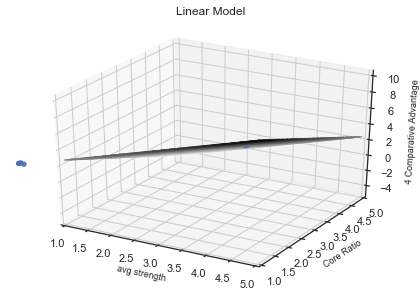




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Eccentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8410559248321874, p-value: [[0.00850402 0.01199147]]
Regression Coefficients: [-0.12098679  0.09597323]
Intercept: 2.843448979672555


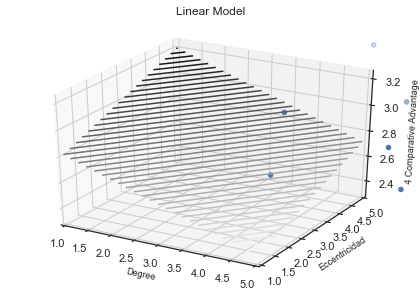




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8281082231556873, p-value: [[0.01177666 0.01327447]]
Regression Coefficients: [-0.10117666  0.08999311]
Intercept: 2.7938101652270806


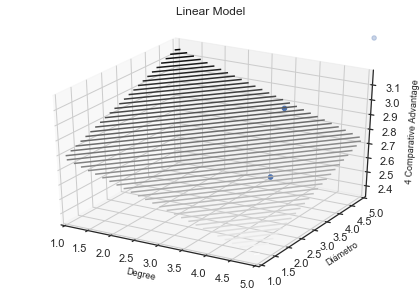




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.872447891966812, p-value: [[0.00286157 0.00891462]]
Regression Coefficients: [-0.14698324  0.09288313]
Intercept: 2.9583825752589235


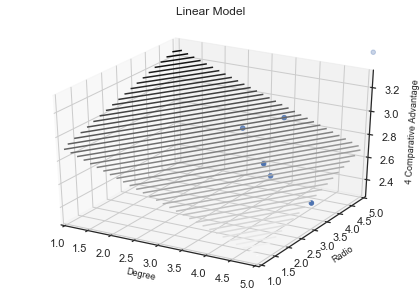




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Camino más corto promedio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8064469147538643, p-value: [[0.00403901 0.01648631]]
Regression Coefficients: [-0.21210741  0.11321349]
Intercept: 3.070264303124462


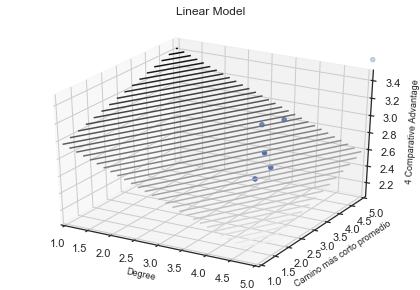




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9726210357735132, p-value: [[0.00027898 0.00042031]]
Regression Coefficients: [ 0.18191949 -0.16396279]
Intercept: 2.731862946983533


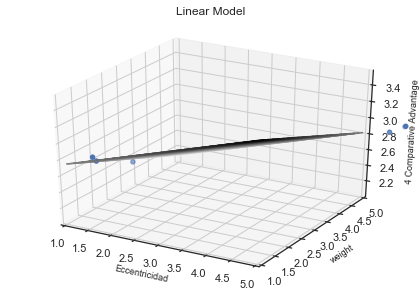




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9229978990570614, p-value: [[0.00166053 0.00305406]]
Regression Coefficients: [ 0.13157882 -0.09794676]
Intercept: 2.677236580092271


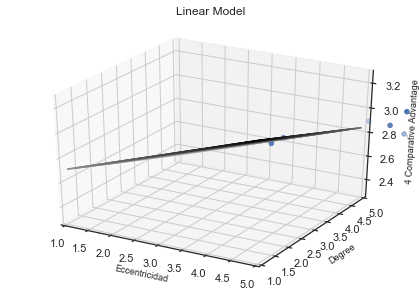




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9520524766700116, p-value: [[0.00091512 0.00146712]]
Regression Coefficients: [ 0.15048909 -0.13636365]
Intercept: 2.72680590399881


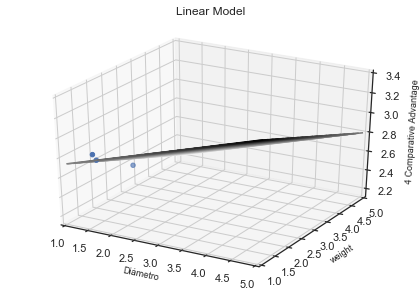




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.959550758273839, p-value: [[0.00059228 0.00076782]]
Regression Coefficients: [ 0.11027825 -0.09498991]
Intercept: 2.746611292144119


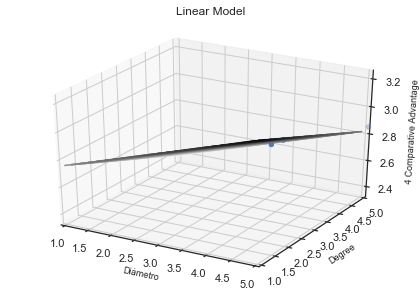




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9922748170629221, p-value: [[2.27146340e-05 2.66830478e-05]]
Regression Coefficients: [ 0.18198355 -0.19411145]
Intercept: 2.789195967659111


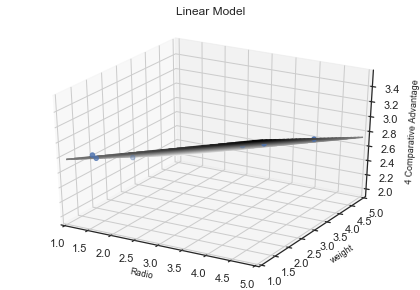




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9909702156131895, p-value: [[3.17041709e-06 1.11781511e-04]]
Regression Coefficients: [ 0.22229227 -0.07847981]
Intercept: 2.2467093213400577


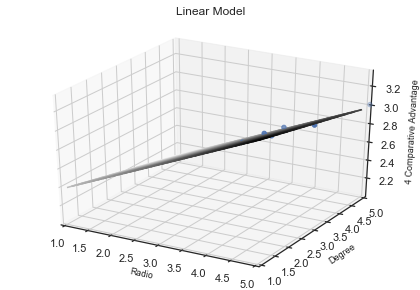




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9654120880911189, p-value: [[0.00043602 0.00060519]]
Regression Coefficients: [ 0.2759129  -0.23934217]
Intercept: 2.736194895239015


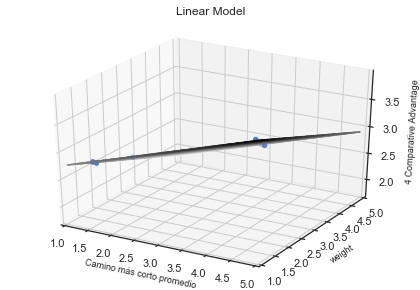




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8221355557358668, p-value: [[0.00046843 0.01828707]]
Regression Coefficients: [ 0.35903365 -0.10517442]
Intercept: 1.9101894380377995


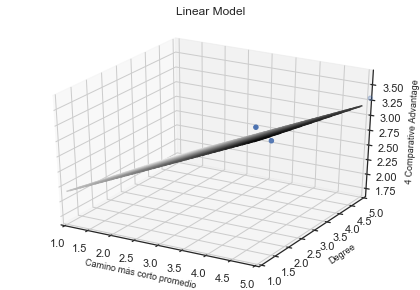




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8487565760723839, p-value: [[0.00914135 0.0095915 ]]
Regression Coefficients: [-2.0495795   2.04740956]
Intercept: 2.752524684564583


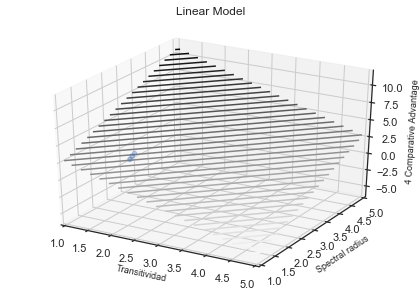




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8264137339316606, p-value: [[0.01646643 0.01906746]]
Regression Coefficients: [-2.13945461  2.07446111]
Intercept: 2.8728863553668056


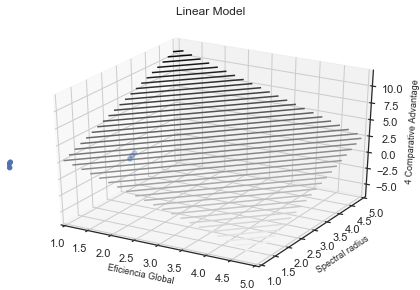




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8135379493050547, p-value: [[0.01269386 0.01277257]]
Regression Coefficients: [-2.10031001  2.10910577]
Intercept: 2.7345476986196826


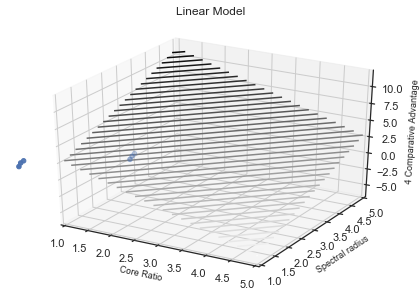




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9084725785109781, p-value: [[0.01190957 0.00125327]]
Regression Coefficients: [-1.12240246 -2.45045439]
Intercept: 3.784812226653128


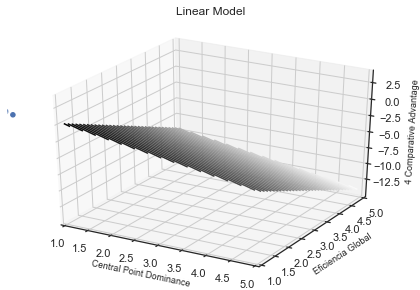




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8542644369416149, p-value: [[0.00887062 0.01446043]]
Regression Coefficients: [-1.40275378  1.24584577]
Intercept: 3.022969224509655


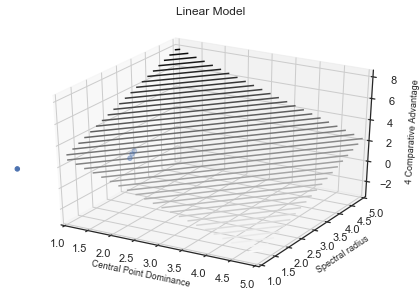




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8961301641393872, p-value: [[0.00411616 0.00426971]]
Regression Coefficients: [ 2.39158856 -2.39856982]
Intercept: 2.813015899522616


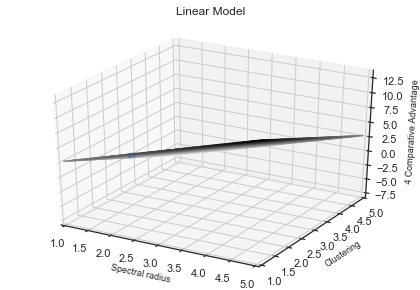




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9811364807385646, p-value: [[0.00012663 0.00013114]]
Regression Coefficients: [ 2.24307609 -2.2517247 ]
Intercept: 2.8211651634560453


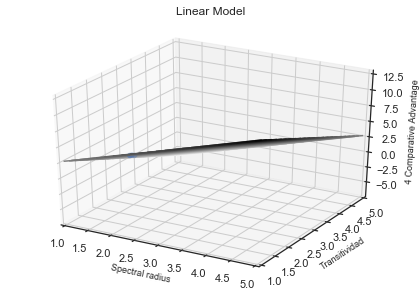




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9183428260073744, p-value: [[0.00343735 0.0039832 ]]
Regression Coefficients: [ 2.28940478 -2.22959398]
Intercept: 2.691286503544358


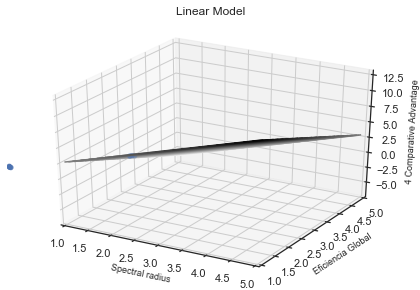




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9571068320668321, p-value: [[0.00058973 0.00058097]]
Regression Coefficients: [ 2.31630753 -2.33927   ]
Intercept: 2.8458457436856417


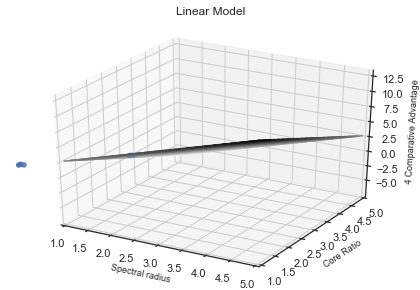

In [22]:
'''
3D linear models for predicting impact and comparative advantage using graph metrics
'''

grf_key_list=list(grf_df.keys())
grf_key_list.remove('Ciudad')
grf_key_list.remove('País')                                   # list of all global metrics

ieco_key_predictors=['4 Comparative Advantage','5 Impact']    # our two predictors

for key1 in grf_key_list:
    for key2 in grf_key_list:                                 # for each pair (a,b) of distinct global metrics
        if key1 != key2:                                      
            for predict in ieco_key_predictors:               # and each predictor
                
                # we make a numpy array with the predicted values and reshape it into 2 rows, 6 columns
                X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = X.reshape(6,2)
                
                # make a numpy array for our predictor
                y=ieco_grf_df[predict].to_numpy()
                
                #make linear regression with X,y data and obtain p-value
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if p-value is small enough and the regression score is greater than 0.8:
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.895258631799094, p-value: [[0.02256249 0.00251289]]
Regression Coefficients: [ 0.82868416 -1.5143133 ]
Intercept: 4.212702586081683


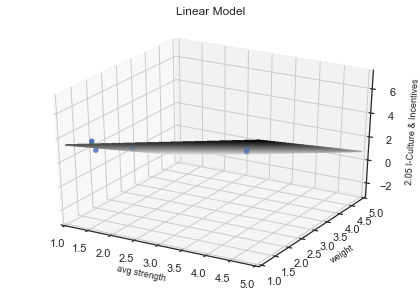




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, weight
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.840376910335701, p-value: [[0.01318754 0.00551553]]
Regression Coefficients: [ 0.35556682 -0.44573879]
Intercept: 3.505540516059705


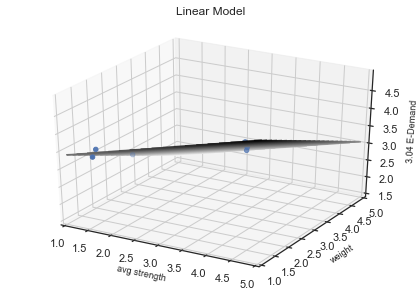




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8916870004016189, p-value: [[4.58014025e-06 6.75977261e-03]]
Regression Coefficients: [ 3.68802102 -0.4511024 ]
Intercept: -9.147444370876006


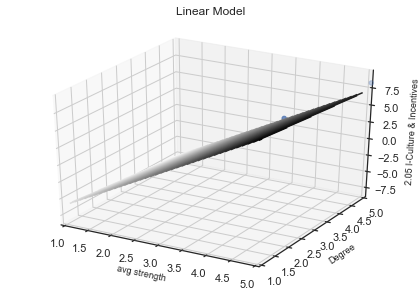




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026306071702491, p-value: [[0.00173048 0.00473411]]
Regression Coefficients: [ 0.27469535 -0.15362493]
Intercept: 1.6359860536108404


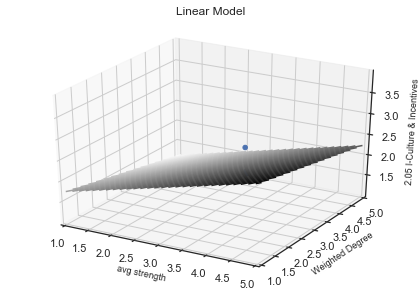




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8057512091463338, p-value: [[0.02118562 0.0153164 ]]
Regression Coefficients: [ 0.05659758 -0.04582451]
Intercept: 3.2276161027268473


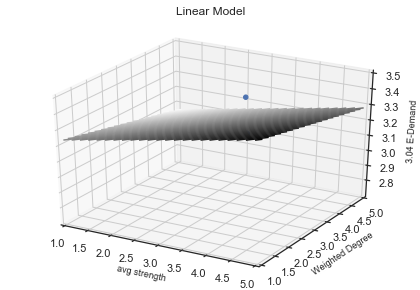




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8655526062772128, p-value: [[0.00806769 0.00845523]]
Regression Coefficients: [ 1.72874085 -1.79178788]
Intercept: 2.7871861116888463


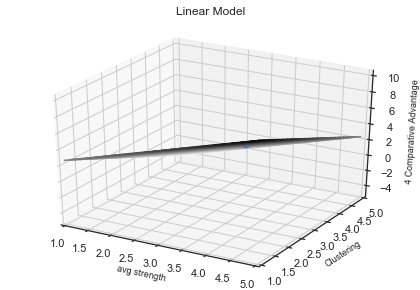




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Transitividad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8067907549326083, p-value: [[0.01266171 0.01139586]]
Regression Coefficients: [ 1.84052953 -1.99372105]
Intercept: 2.2697794526364947


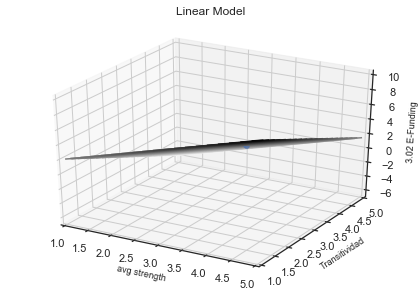




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9614385297472103, p-value: [[0.00060939 0.00063759]]
Regression Coefficients: [ 1.71486568 -1.78025141]
Intercept: 2.797470664186466


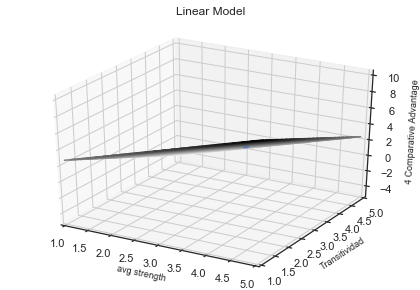




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8570821122307695, p-value: [[0.00833965 0.00778247]]
Regression Coefficients: [ 1.96528674 -2.10523997]
Intercept: 2.204512825695242


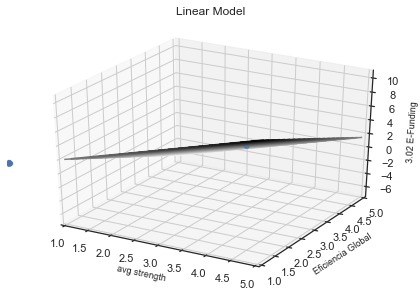




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026624487127016, p-value: [[0.00509078 0.00558599]]
Regression Coefficients: [ 1.70507095 -1.74548288]
Intercept: 2.7168644705934555


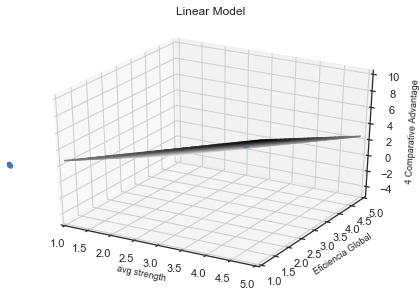




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Small Worldness
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8265109511412067, p-value: [[0.00212509 0.00157923]]
Regression Coefficients: [-1.5865702   1.76271264]
Intercept: 1.1844715762967153


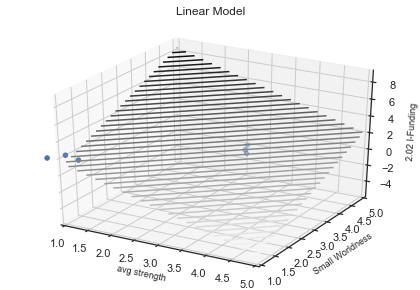




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Core Ratio
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8257748859511451, p-value: [[0.00842383 0.00719442]]
Regression Coefficients: [ 1.90575128 -2.08733297]
Intercept: 2.3516189036577035


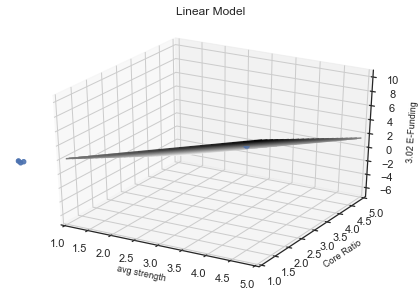




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.928705965938175, p-value: [[0.00171129 0.00172726]]
Regression Coefficients: [ 1.72520365 -1.80251961]
Intercept: 2.83502623697475


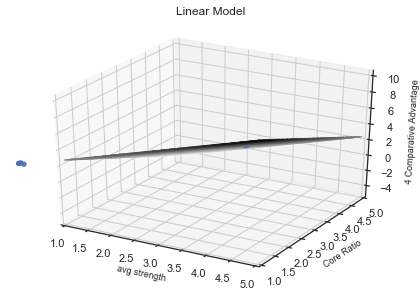




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8518532400990135, p-value: [[0.00697043 0.00750405]]
Regression Coefficients: [ 2.48022039 -2.55985767]
Intercept: 2.142749020623247


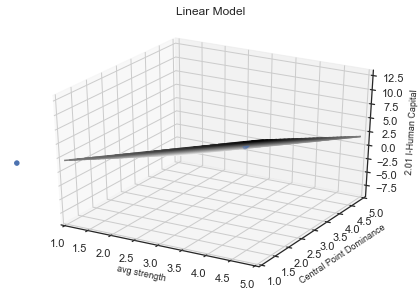




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9145174772899951, p-value: [[0.00235546 0.00245158]]
Regression Coefficients: [ 1.53619193 -1.60161324]
Intercept: 2.0305511063439186


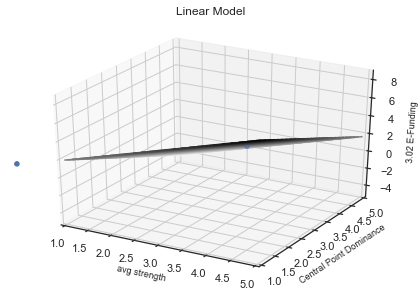




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Spectral radius
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8472705888056411, p-value: [[0.01341798 0.0163393 ]]
Regression Coefficients: [-1.61196241  1.58459391]
Intercept: 1.8647974080358234


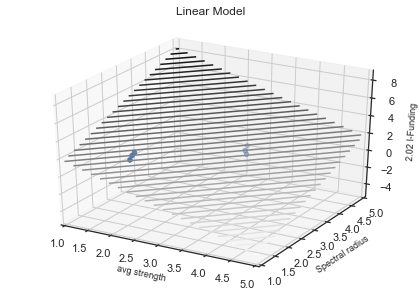




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.977820491308003, p-value: [[0.00018754 0.00015061]]
Regression Coefficients: [-0.6900992   0.71320393]
Intercept: 3.112349361253397


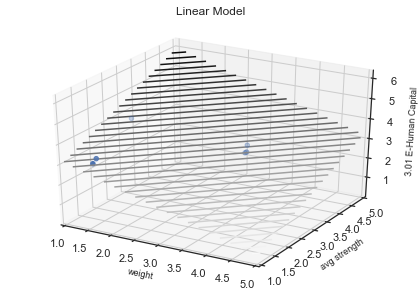




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Degree
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8254770170859531, p-value: [[0.00539603 0.02660709]]
Regression Coefficients: [ 0.27965238 -0.12156903]
Intercept: 1.330108983794044


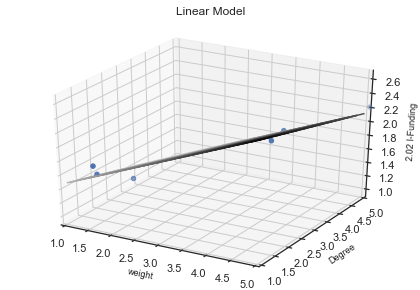




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8386738536040019, p-value: [[0.00561    0.01336874]]
Regression Coefficients: [ 0.89092203 -0.48323969]
Intercept: 1.7214204101890849


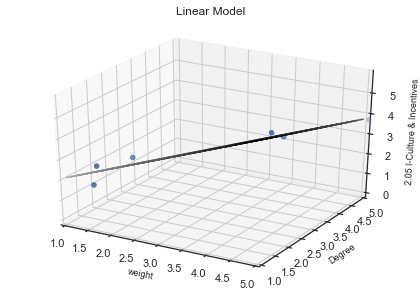




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8917145522769856, p-value: [[0.00357902 0.00599521]]
Regression Coefficients: [ 0.24488916 -0.1531878 ]
Intercept: 2.0201230267112367


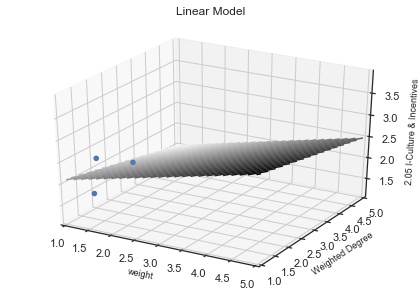




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8083057477154643, p-value: [[0.02871027 0.01543193]]
Regression Coefficients: [ 0.05247816 -0.04585212]
Intercept: 3.2826875004477776


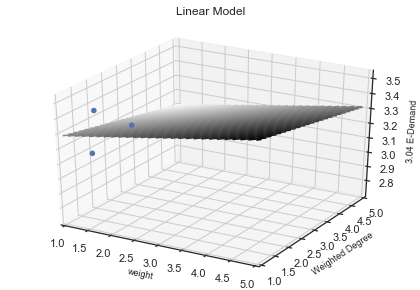




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9454492966985942, p-value: [[0.00953994 0.00174504]]
Regression Coefficients: [-0.61454306  0.70797259]
Intercept: 3.0200035646834227


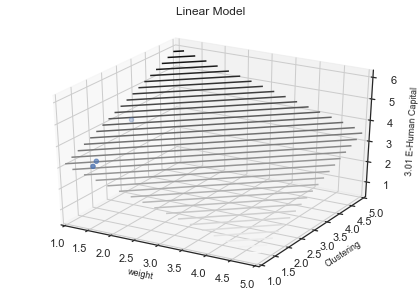




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9379715046529226, p-value: [[0.01231781 0.00225259]]
Regression Coefficients: [-0.60672225  0.70268063]
Intercept: 3.018353054594666


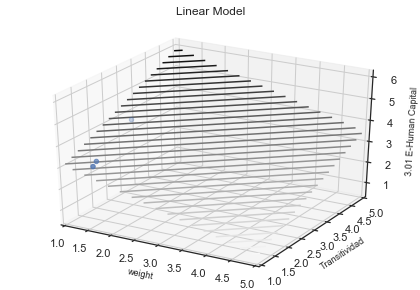




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.936615934588517, p-value: [[0.01165236 0.0023302 ]]
Regression Coefficients: [-0.61378471  0.70111662]
Intercept: 3.032296597015376


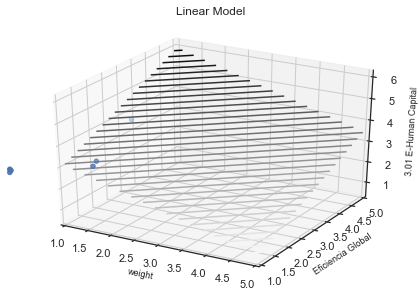




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Small Worldness
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9796849288966152, p-value: [[0.0246934 0.0002011]]
Regression Coefficients: [-0.27022447  0.74630065]
Intercept: 2.4606801614530416


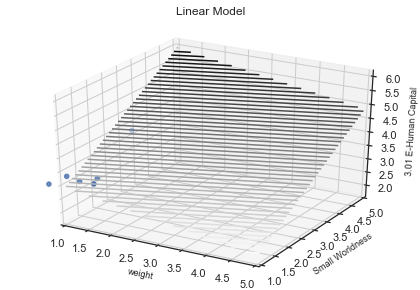




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9397579199901743, p-value: [[0.01320964 0.00207892]]
Regression Coefficients: [-0.5772066   0.70730165]
Intercept: 2.9674218967693675


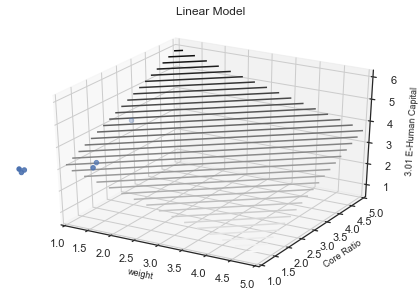




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.885239297134209, p-value: [[0.03519718 0.00788233]]
Regression Coefficients: [-0.55195405  0.6425944 ]
Intercept: 3.0717350927223133


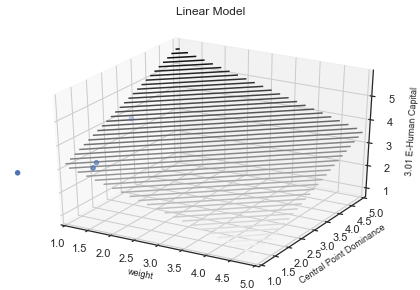




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Spectral radius
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9711175259281214, p-value: [[0.00033384 0.0003244 ]]
Regression Coefficients: [-0.80672393  0.71226747]
Intercept: 3.275439808386623


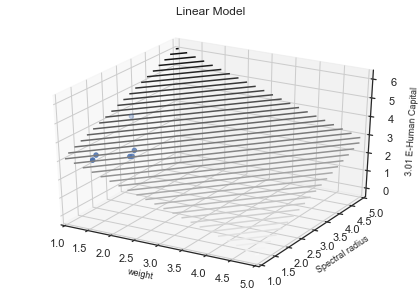




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8339414630481272, p-value: [[0.00759237 0.0145025 ]]
Regression Coefficients: [ 0.23847583 -0.14206038]
Intercept: 1.9126297713488252


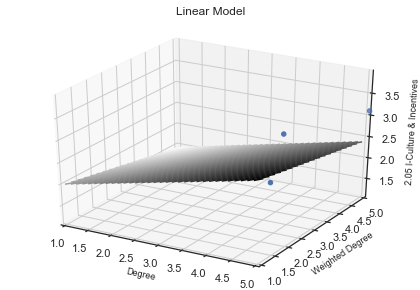




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Eccentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8410559248321874, p-value: [[0.00850402 0.01199147]]
Regression Coefficients: [-0.12098679  0.09597323]
Intercept: 2.843448979672555


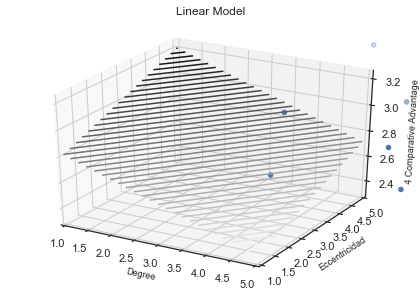




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9250556618993726, p-value: [[0.01604979 0.00352928]]
Regression Coefficients: [-0.23690857  0.25187085]
Intercept: 3.051030623774334


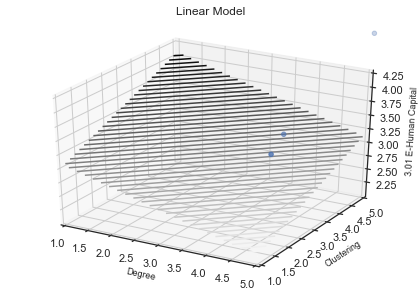




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8281082231556873, p-value: [[0.01177666 0.01327447]]
Regression Coefficients: [-0.10117666  0.08999311]
Intercept: 2.7938101652270806


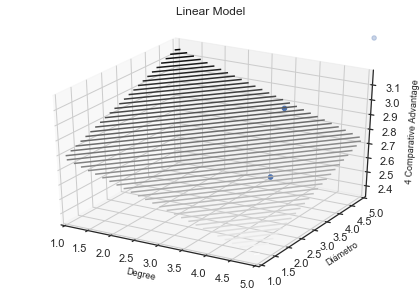




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9446754429962418, p-value: [[9.07212511e-05 7.40442723e-04]]
Regression Coefficients: [-0.27593194 -0.13956622]
Intercept: 3.3018048979115395


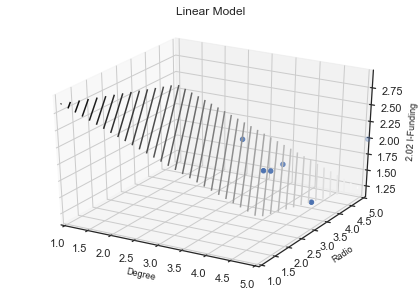




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9677188495220663, p-value: [[0.025957   0.00019031]]
Regression Coefficients: [0.0754655  0.24959871]
Intercept: 1.9039186509035706


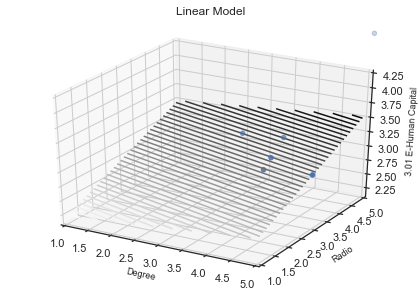




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.872447891966812, p-value: [[0.00286157 0.00891462]]
Regression Coefficients: [-0.14698324  0.09288313]
Intercept: 2.9583825752589235


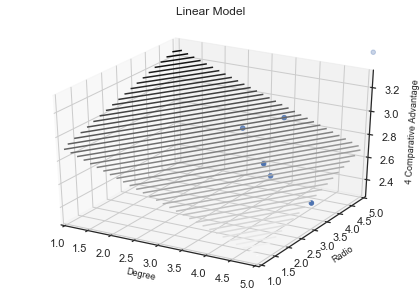




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Camino más corto promedio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.966124285251148, p-value: [[0.00273846 0.00039155]]
Regression Coefficients: [0.18985875 0.25191135]
Intercept: 1.4530215463195981


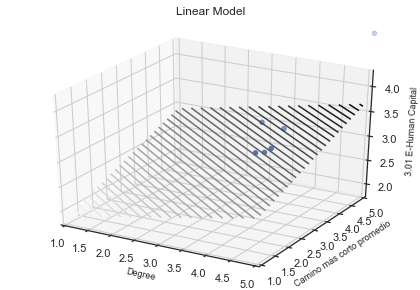




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Camino más corto promedio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8064469147538643, p-value: [[0.00403901 0.01648631]]
Regression Coefficients: [-0.21210741  0.11321349]
Intercept: 3.070264303124462


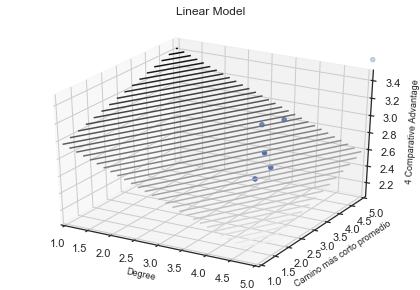




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.923448748335753, p-value: [[0.01678537 0.00368116]]
Regression Coefficients: [-0.23614128  0.25153095]
Intercept: 3.0497716072022354


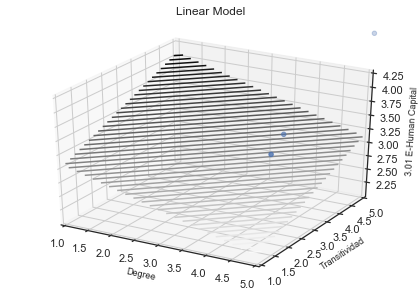




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9223660598525802, p-value: [[0.01659462 0.0037818 ]]
Regression Coefficients: [-0.23794536  0.25116834]
Intercept: 3.058878205411345


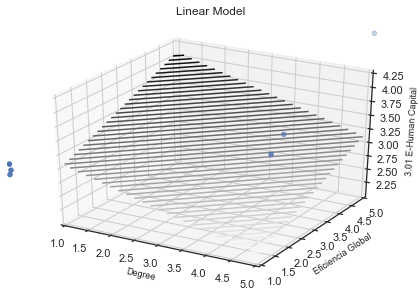




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Small Worldness
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9355305447926738, p-value: [[0.01643308 0.00259887]]
Regression Coefficients: [-0.2159424   0.25296411]
Intercept: 2.9684883099855526


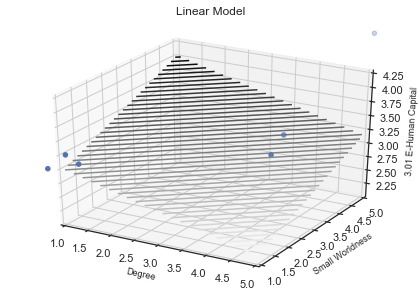




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9238896458585394, p-value: [[0.01683721 0.00362317]]
Regression Coefficients: [-0.2345113   0.25172412]
Intercept: 3.04250659386886


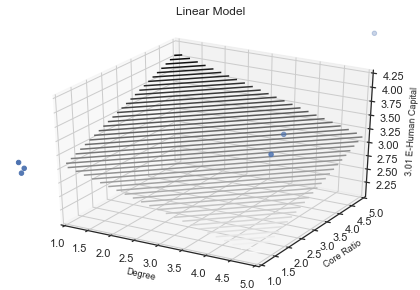




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9064997295095754, p-value: [[0.02288975 0.00557084]]
Regression Coefficients: [-0.23427535  0.24573627]
Intercept: 3.0775048047594415


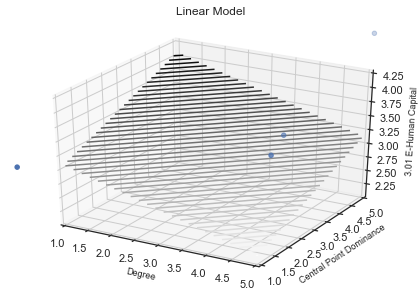




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Spectral radius
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.938062071766339, p-value: [[0.0084635  0.00200598]]
Regression Coefficients: [-0.23277912  0.25294509]
Intercept: 3.0323932979889348


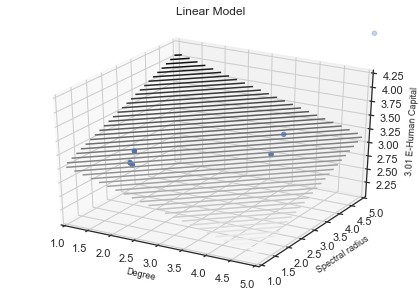




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9607015473685515, p-value: [[0.00388977 0.00085931]]
Regression Coefficients: [-0.06922337  0.07585327]
Intercept: 3.057869581706675


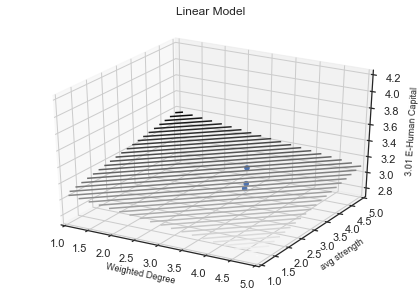




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, weight
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9383525239322736, p-value: [[0.01207788 0.00224858]]
Regression Coefficients: [-0.06472565  0.0744422 ]
Intercept: 3.022803594666366


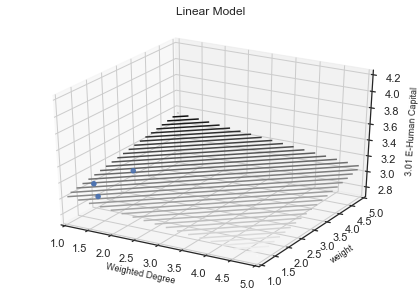




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Eccentricidad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.972357006809853, p-value: [[0.00193327 0.00039327]]
Regression Coefficients: [-0.06567758  0.07468518]
Intercept: 3.033636273960809


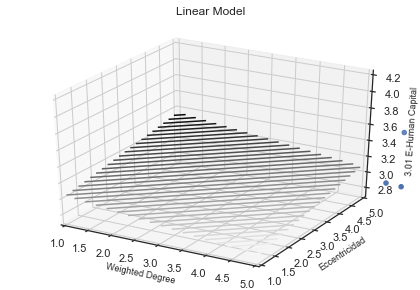




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9548732845393242, p-value: [[0.00559989 0.00120265]]
Regression Coefficients: [-0.069314    0.07557772]
Intercept: 3.063589408642712


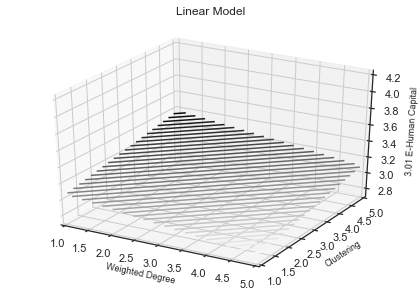




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Diámetro
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9690470501829723, p-value: [[0.00260641 0.00046886]]
Regression Coefficients: [-0.06116442  0.07355722]
Intercept: 2.9984047565076004


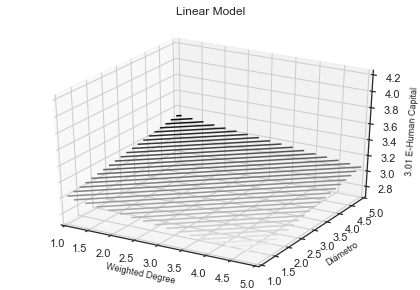




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9700864758503515, p-value: [[0.00179543 0.00046049]]
Regression Coefficients: [-0.07052813  0.07464925]
Intercept: 3.09854384574939


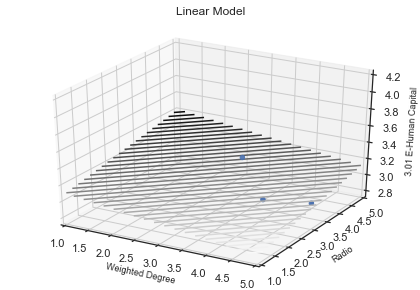




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Camino más corto promedio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9747072366053596, p-value: [[0.0017472  0.00035288]]
Regression Coefficients: [-0.06849674  0.0761532 ]
Intercept: 3.042626513475242


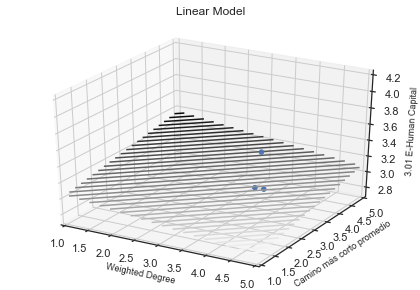




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9545005898841088, p-value: [[0.00569633 0.00122255]]
Regression Coefficients: [-0.06926779  0.0755599 ]
Intercept: 3.0632642546674407


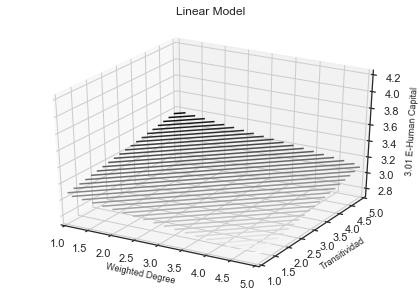




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9541807661227469, p-value: [[0.00572554 0.00124049]]
Regression Coefficients: [-0.06939902  0.07553163]
Intercept: 3.065530120761944


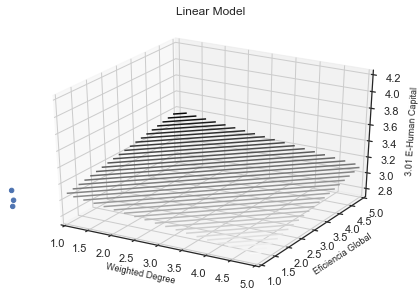




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Small Worldness
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9576520480883371, p-value: [[0.00537136 0.00105602]]
Regression Coefficients: [-0.06788383  0.07573758]
Intercept: 3.042404196612282


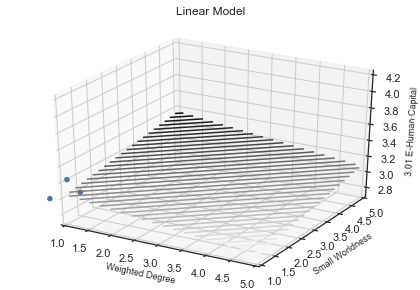




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9545415343539796, p-value: [[0.00573129 0.00121916]]
Regression Coefficients: [-0.06910601  0.07558023]
Intercept: 3.0607048417796188


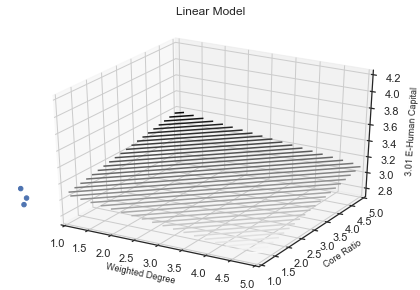




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9503709615576599, p-value: [[0.00660304 0.00146485]]
Regression Coefficients: [-0.06935271  0.07519798]
Intercept: 3.0715941155546163


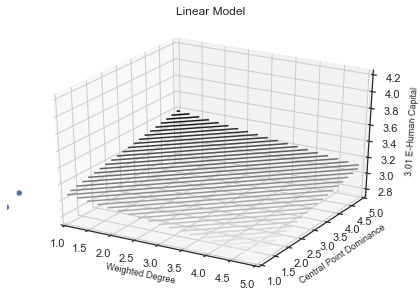




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Spectral radius
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9590225828685598, p-value: [[0.00459145 0.00097456]]
Regression Coefficients: [-0.06914802  0.07579257]
Intercept: 3.0577694308285657


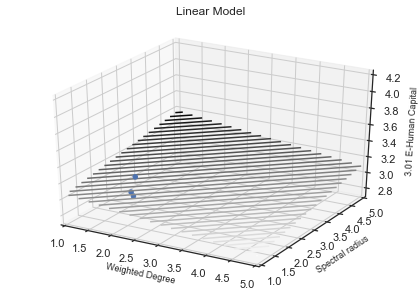




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9726210357735132, p-value: [[0.00027898 0.00042031]]
Regression Coefficients: [ 0.18191949 -0.16396279]
Intercept: 2.731862946983533


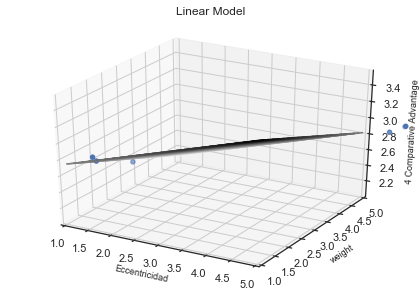




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, Degree
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8805941026331737, p-value: [[0.04646008 0.00307083]]
Regression Coefficients: [ 0.05634178 -0.11078945]
Intercept: 3.2025533119043543


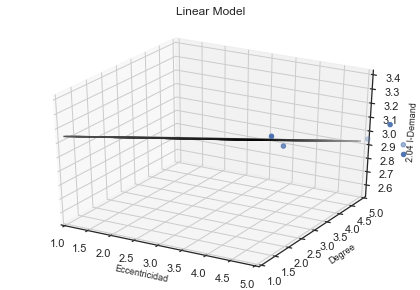




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8787573825841564, p-value: [[0.02599202 0.00261068]]
Regression Coefficients: [-0.29543499 -0.50072789]
Intercept: 6.364352598125709


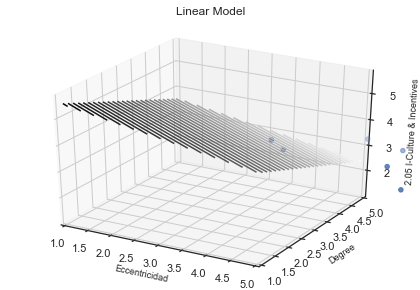




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9229978990570614, p-value: [[0.00166053 0.00305406]]
Regression Coefficients: [ 0.13157882 -0.09794676]
Intercept: 2.677236580092271


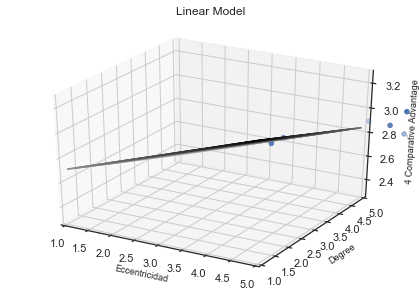




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8999811165611383, p-value: [[0.0010482  0.00498823]]
Regression Coefficients: [ 0.29772697 -0.14720956]
Intercept: 1.2138574508588584


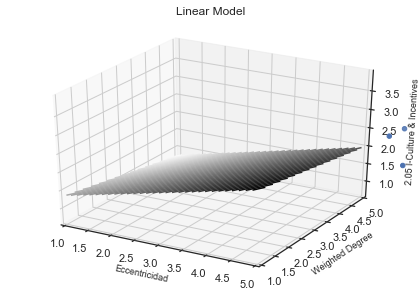




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eccentricidad, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.809088537412606, p-value: [[0.01609423 0.01424444]]
Regression Coefficients: [ 0.05718482 -0.04452803]
Intercept: 3.194379214524713


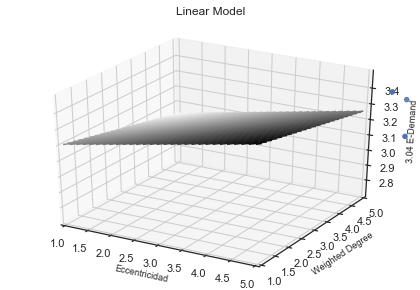




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8596750680427206, p-value: [[0.00647684 0.01007305]]
Regression Coefficients: [ 2.23117074 -1.42261858]
Intercept: 2.0752184337934585


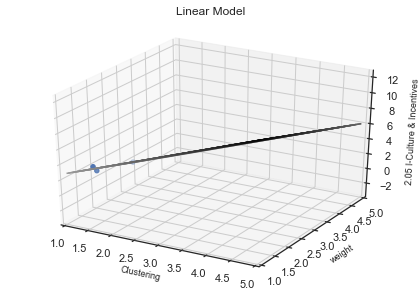




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9102666524448041, p-value: [[0.00260297 0.00395358]]
Regression Coefficients: [ 0.87743815 -0.54195551]
Intercept: 2.078277731631279


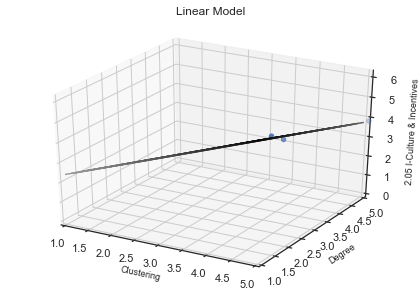




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8920439225435403, p-value: [[0.0038175  0.00592185]]
Regression Coefficients: [ 0.24161239 -0.1543387 ]
Intercept: 2.082797964241661


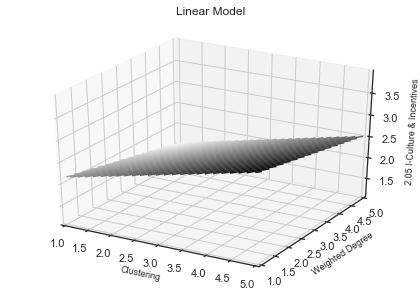




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.80049339606427, p-value: [[0.02984799 0.01679684]]
Regression Coefficients: [ 0.05316801 -0.04585573]
Intercept: 3.2738944218870647


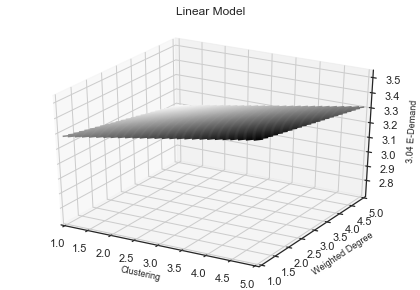




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Eccentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8059401779810753, p-value: [[0.02798119 0.01633718]]
Regression Coefficients: [-0.60690613  0.73942563]
Intercept: 2.043770766508012


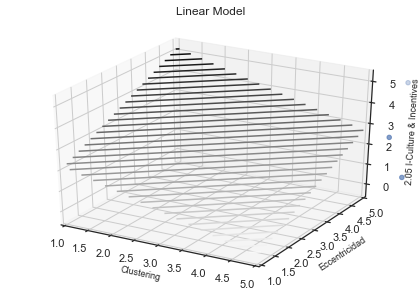




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8068903495437247, p-value: [[0.02413357 0.01526557]]
Regression Coefficients: [-0.52248355  0.629115  ]
Intercept: 2.0585809972878653


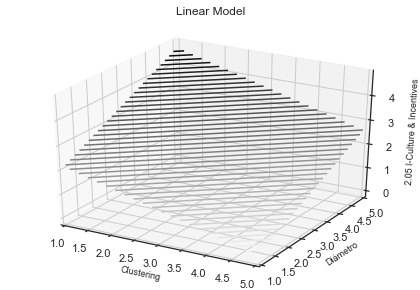




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8455135608804701, p-value: [[0.01536468 0.0083646 ]]
Regression Coefficients: [-0.69950957  1.01194988]
Intercept: 2.0180860669497545


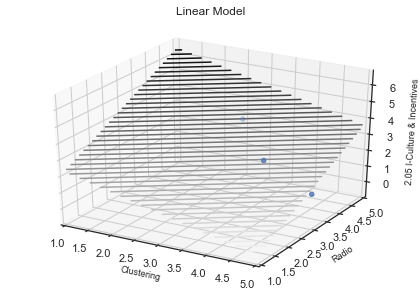




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Small Worldness
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9081087768979821, p-value: [[0.00344795 0.00378653]]
Regression Coefficients: [-3.13880149  2.44705072]
Intercept: 3.223312254373985


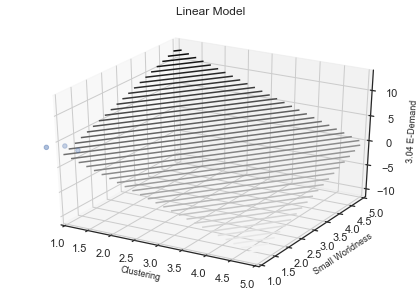




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Central Point Dominance
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9133453996007057, p-value: [[0.00268612 0.00016482]]
Regression Coefficients: [-2.24378353  5.9794384 ]
Intercept: 2.4144812585479176


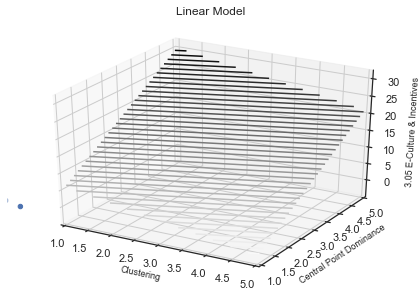




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8447777025616302, p-value: [[0.00736157 0.00706607]]
Regression Coefficients: [-2.26302287  2.31914418]
Intercept: 2.8032907341201363


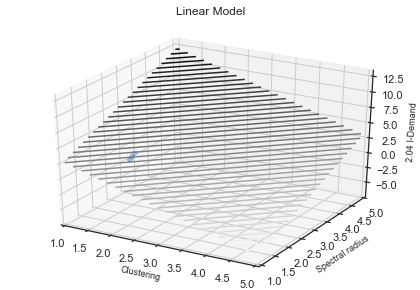




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Spectral radius
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8772468684919791, p-value: [[0.00583663 0.00461908]]
Regression Coefficients: [-9.22140636  9.96639184]
Intercept: 1.4899791025465485


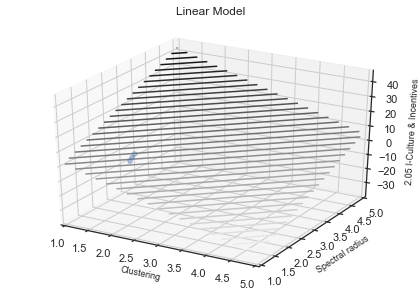




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9520524766700116, p-value: [[0.00091512 0.00146712]]
Regression Coefficients: [ 0.15048909 -0.13636365]
Intercept: 2.72680590399881


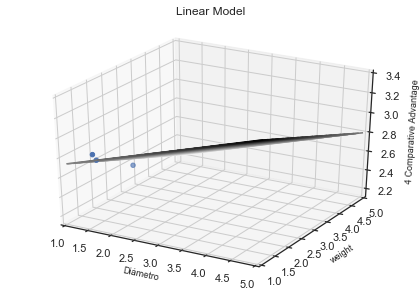




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Degree
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8751596140973867, p-value: [[0.01711542 0.00313892]]
Regression Coefficients: [ 0.07019207 -0.10462028]
Intercept: 3.12505155960744


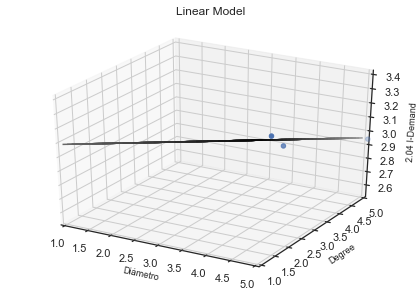




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.959550758273839, p-value: [[0.00059228 0.00076782]]
Regression Coefficients: [ 0.11027825 -0.09498991]
Intercept: 2.746611292144119


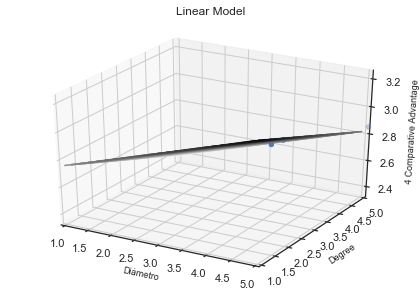




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8581901969194263, p-value: [[0.00143522 0.01045432]]
Regression Coefficients: [ 0.31116545 -0.13851816]
Intercept: 0.8611233619586669


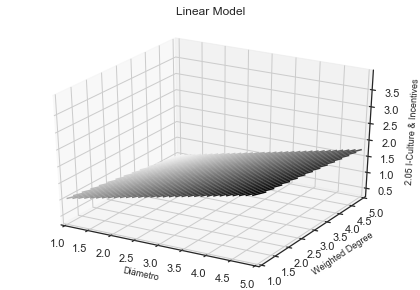




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.959907514434251, p-value: [[3.26106991e-05 9.19857802e-05]]
Regression Coefficients: [0.8775418 0.7674175]
Intercept: -2.564545906965954


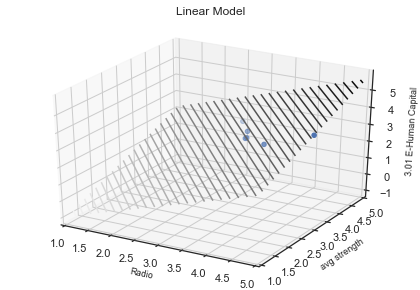




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9922748170629221, p-value: [[2.27146340e-05 2.66830478e-05]]
Regression Coefficients: [ 0.18198355 -0.19411145]
Intercept: 2.789195967659111


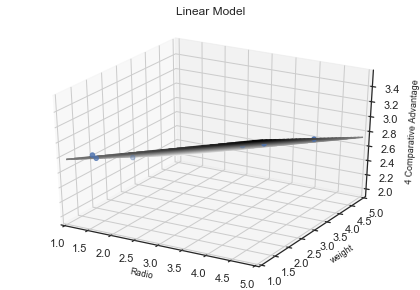




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9909702156131895, p-value: [[3.17041709e-06 1.11781511e-04]]
Regression Coefficients: [ 0.22229227 -0.07847981]
Intercept: 2.2467093213400577


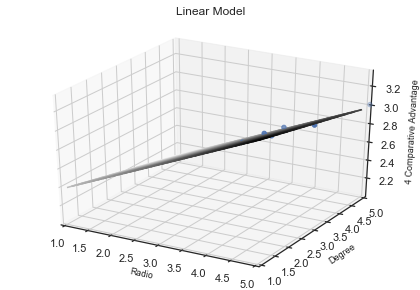




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8791559728936014, p-value: [[0.00212931 0.00720164]]
Regression Coefficients: [ 0.27476161 -0.14614763]
Intercept: 1.4884102247206883


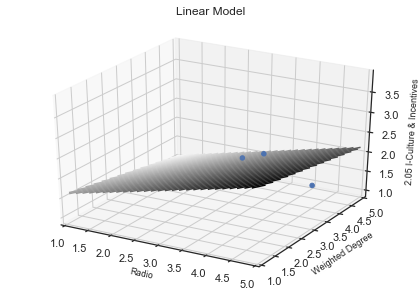




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Camino más corto promedio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.881083964875237, p-value: [[0.00012217 0.00071116]]
Regression Coefficients: [0.91304633 0.64123432]
Intercept: -2.4339424381627874


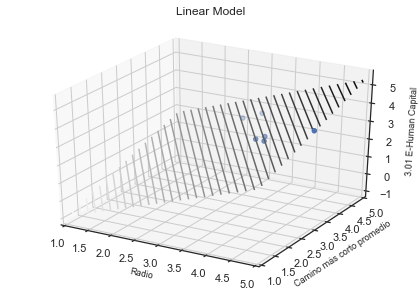




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, weight
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.836664492262315, p-value: [[0.01233459 0.00887775]]
Regression Coefficients: [ 0.22129253 -0.2297669 ]
Intercept: 2.9522286938147033


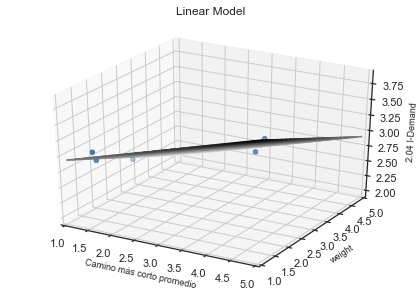




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9654120880911189, p-value: [[0.00043602 0.00060519]]
Regression Coefficients: [ 0.2759129  -0.23934217]
Intercept: 2.736194895239015


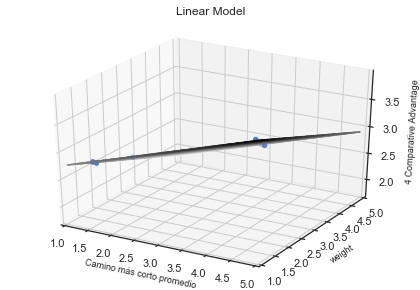




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9382604046563987, p-value: [[3.56752994e-05 2.35941485e-03]]
Regression Coefficients: [ 0.37028516 -0.10046823]
Intercept: 1.9529020063940867


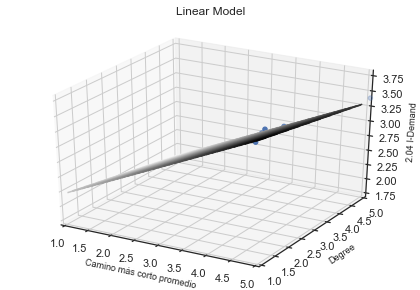




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9630514002457218, p-value: [[8.41868749e-07 1.51762906e-02]]
Regression Coefficients: [ 0.88069812 -0.05539448]
Intercept: -0.9121313581789026


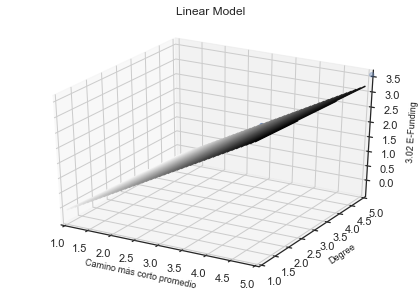




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8221355557358668, p-value: [[0.00046843 0.01828707]]
Regression Coefficients: [ 0.35903365 -0.10517442]
Intercept: 1.9101894380377995


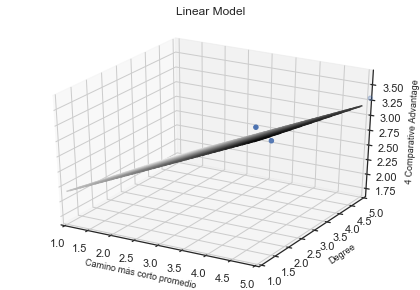




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.922565491109057, p-value: [[0.00109866 0.00303622]]
Regression Coefficients: [ 0.27465629 -0.15377206]
Intercept: 1.6406521142959443


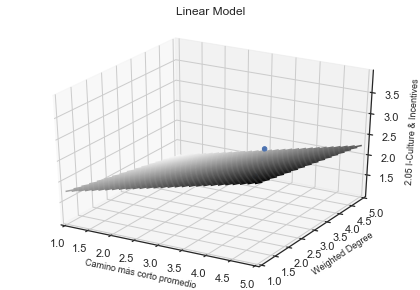




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.825786664765931, p-value: [[0.01744989 0.01226932]]
Regression Coefficients: [ 0.05658404 -0.04608419]
Intercept: 3.233035576136477


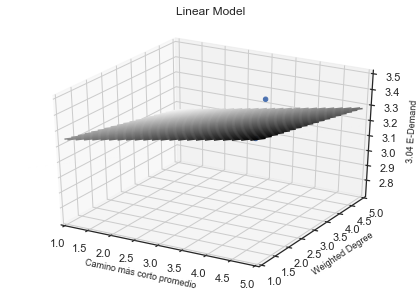




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8331959543251862, p-value: [[0.00880801 0.00809614]]
Regression Coefficients: [-3.13552041  3.37343915]
Intercept: 2.0787066722781327


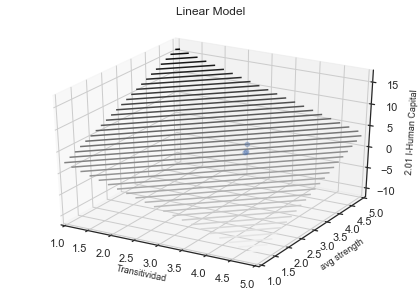




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8631698706869951, p-value: [[0.00639134 0.00951885]]
Regression Coefficients: [ 2.20511445 -1.42241567]
Intercept: 2.1126907593047


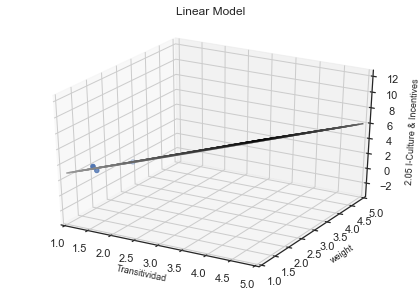




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9125809057650868, p-value: [[0.00250813 0.00374732]]
Regression Coefficients: [ 0.87440212 -0.54252447]
Intercept: 2.093115439110773


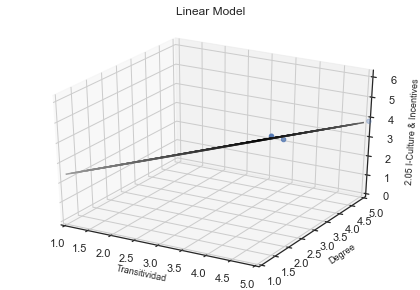




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8927954397790925, p-value: [[0.00377937 0.00583678]]
Regression Coefficients: [ 0.24142183 -0.15441517]
Intercept: 2.086711132238502


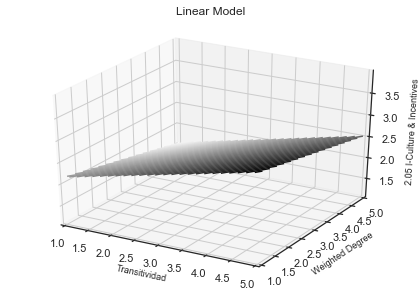




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8016530542868104, p-value: [[0.02956037 0.0165894 ]]
Regression Coefficients: [ 0.0531776  -0.04589195]
Intercept: 3.2744312785972065


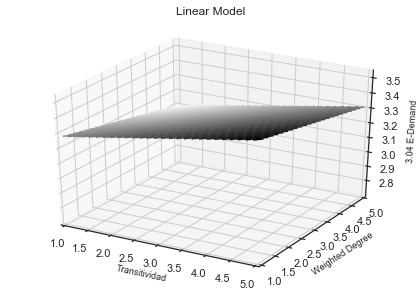




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Eccentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8018453680499442, p-value: [[0.02921634 0.01705716]]
Regression Coefficients: [-0.60427094  0.73684157]
Intercept: 2.0428531421122593


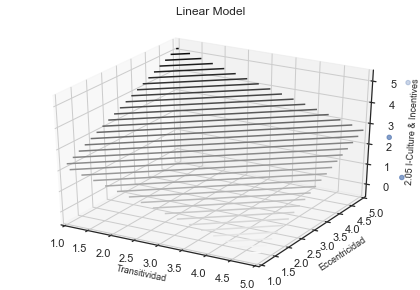




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8035304895298322, p-value: [[0.02501225 0.01581698]]
Regression Coefficients: [-0.52077563  0.62745077]
Intercept: 2.057646097226591


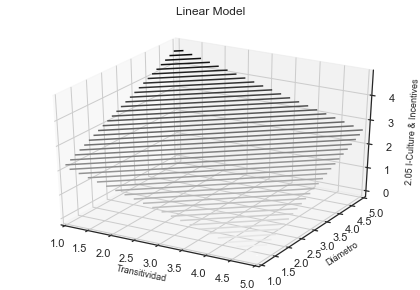




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8396508172060778, p-value: [[0.01654538 0.00905791]]
Regression Coefficients: [-0.69612308  1.00655414]
Intercept: 2.0219531407387876


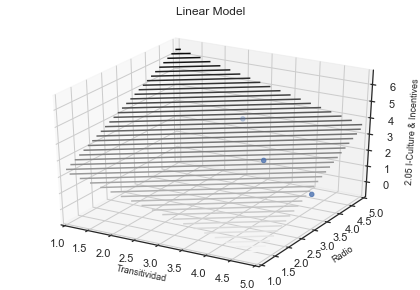




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Eficiencia Global
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8699070938551887, p-value: [[0.00658991 0.00739766]]
Regression Coefficients: [ 3.38927628 -2.95513563]
Intercept: 1.6514787725972948


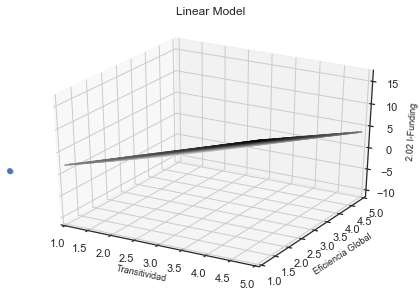




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Core Ratio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9203695426898337, p-value: [[0.00251417 0.00295461]]
Regression Coefficients: [ 3.92965232 -3.16930868]
Intercept: 1.6342055306490821


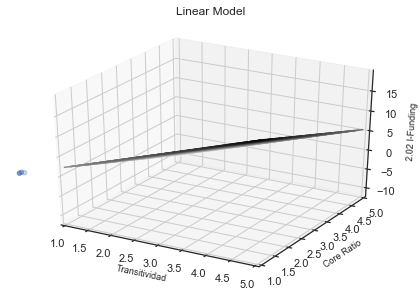




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Central Point Dominance
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9350367816625526, p-value: [[0.00194417 0.00034957]]
Regression Coefficients: [-1.9886017   4.03627081]
Intercept: 2.7539318540404865


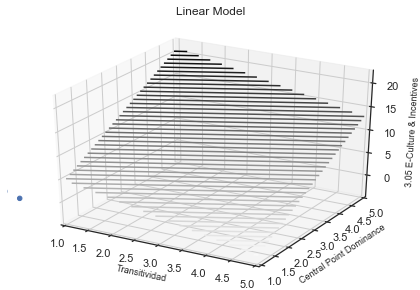




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8487565760723839, p-value: [[0.00914135 0.0095915 ]]
Regression Coefficients: [-2.0495795   2.04740956]
Intercept: 2.752524684564583


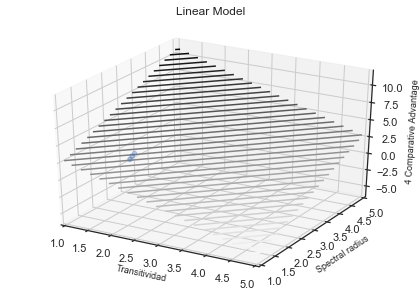




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8093408861613117, p-value: [[0.01436707 0.01375716]]
Regression Coefficients: [-3.19869213  3.4033563 ]
Intercept: 2.1994085976133957


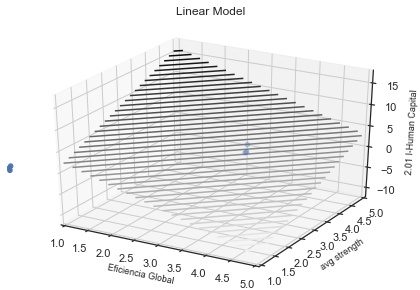




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8535149226955466, p-value: [[0.00500768 0.01111907]]
Regression Coefficients: [ 2.40420137 -1.40150339]
Intercept: 1.7948485543961428


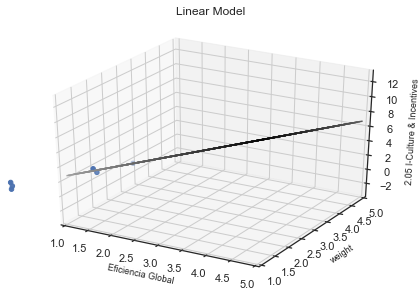




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9092768042106392, p-value: [[0.00237326 0.00404504]]
Regression Coefficients: [ 0.9014766  -0.54066644]
Intercept: 1.980919074482576


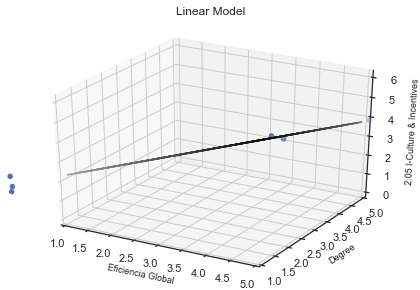




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8919260001616032, p-value: [[0.003724   0.00594817]]
Regression Coefficients: [ 0.24332998 -0.15421752]
Intercept: 2.058293212450714


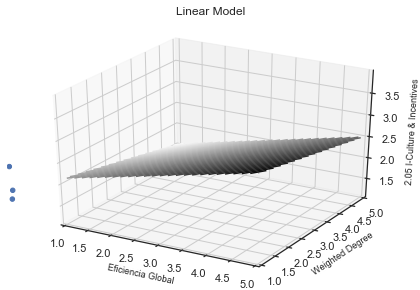




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Eccentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.808460715038033, p-value: [[0.02724613 0.01595639]]
Regression Coefficients: [-0.6082039   0.73998232]
Intercept: 2.0484025980783


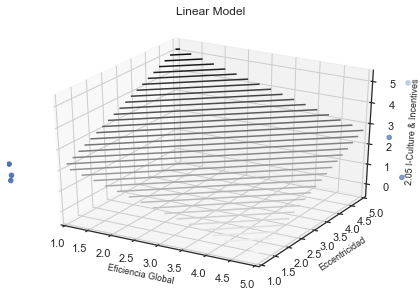




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.809157687735021, p-value: [[0.02354063 0.01494621]]
Regression Coefficients: [-0.52354488  0.62945436]
Intercept: 2.0639063806894864


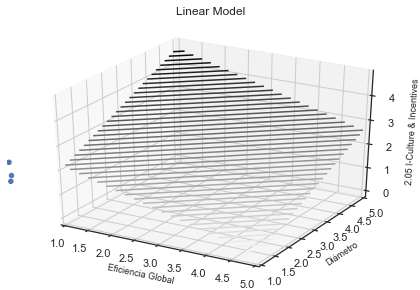




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.848712853570651, p-value: [[0.01492924 0.00790175]]
Regression Coefficients: [-0.69824659  1.01697386]
Intercept: 1.9965159652682138


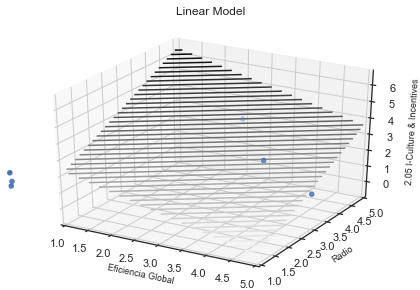




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Small Worldness
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8471698476444972, p-value: [[0.00906278 0.01672862]]
Regression Coefficients: [-2.64876163  1.80217991]
Intercept: 3.5178182300658247


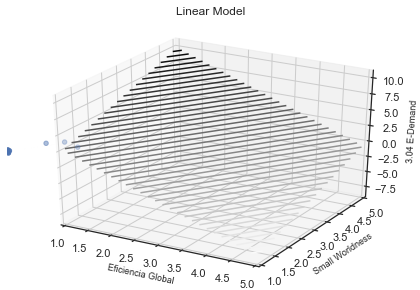




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.86286288858597, p-value: [[0.00772933 0.00812106]]
Regression Coefficients: [-2.1565531   2.15574948]
Intercept: 2.9076390467317603


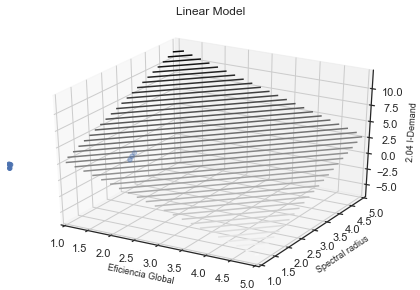




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8264137339316606, p-value: [[0.01646643 0.01906746]]
Regression Coefficients: [-2.13945461  2.07446111]
Intercept: 2.8728863553668056


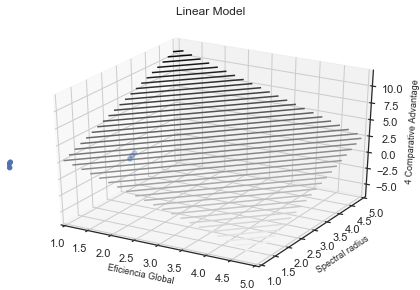




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8842342414382175, p-value: [[0.00349492 0.00653263]]
Regression Coefficients: [ 0.91099247 -0.5341448 ]
Intercept: 1.891875817945154


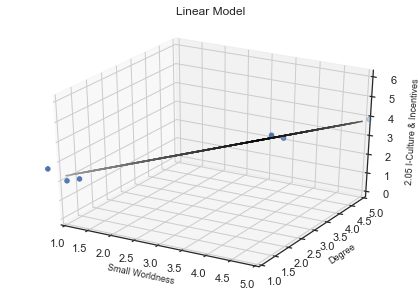




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8875872317829947, p-value: [[0.00396164 0.00642072]]
Regression Coefficients: [ 0.24391337 -0.15394884]
Intercept: 2.042723809979141


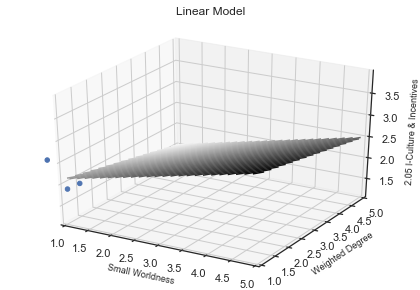




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9453672998409359, p-value: [[0.00211275 0.00300187]]
Regression Coefficients: [ 4.60810032 -3.35398193]
Intercept: 3.11136662703323


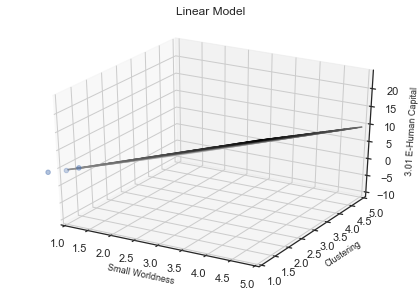




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.800802875036596, p-value: [[0.02872403 0.00783612]]
Regression Coefficients: [-0.62870358  1.091487  ]
Intercept: 1.4458837099353357


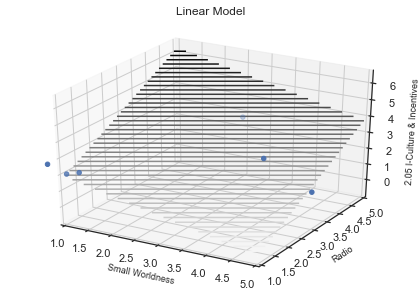




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8726941110132982, p-value: [[0.01113976 0.01556001]]
Regression Coefficients: [ 4.00519629 -2.89683076]
Intercept: 3.1473060961425476


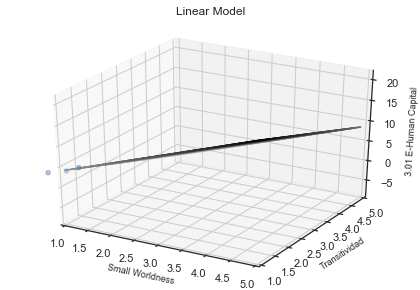




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8953546170247122, p-value: [[0.00748687 0.02027685]]
Regression Coefficients: [ 3.86259939 -2.34735521]
Intercept: 2.6323662644973873


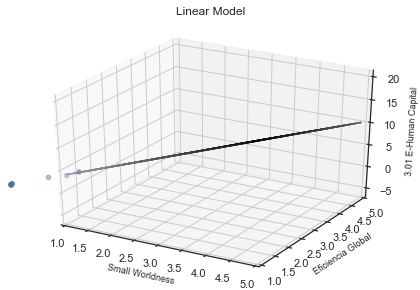




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.906323407489012, p-value: [[0.00741488 0.02154083]]
Regression Coefficients: [ 4.00166839 -2.37347867]
Intercept: 2.5304669271605498


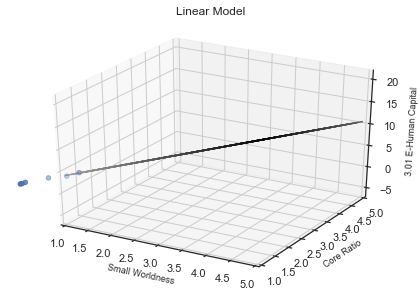




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8292086243411937, p-value: [[0.00680376 0.01354278]]
Regression Coefficients: [ 2.64374351 -1.81933679]
Intercept: 1.9594989955042041


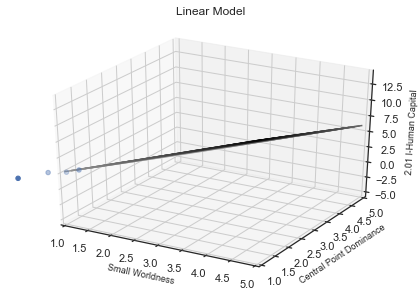




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Central Point Dominance
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8810533883194609, p-value: [[0.0037269  0.00516123]]
Regression Coefficients: [ 1.71579631 -1.31643871]
Intercept: 3.388309501610369


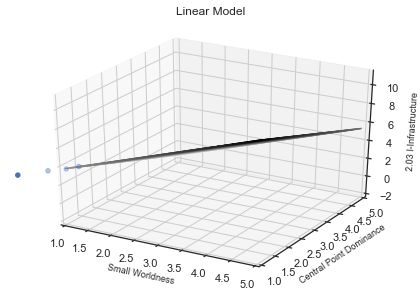




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Central Point Dominance
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9548931420548185, p-value: [[0.00052065 0.0007157 ]]
Regression Coefficients: [ 1.63041815 -1.25978181]
Intercept: 3.744533075001081


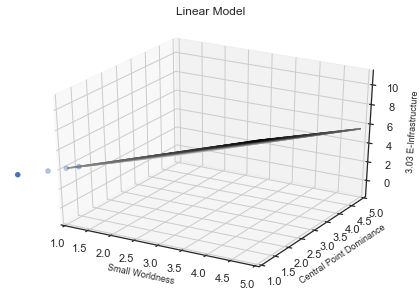




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.825422366373618, p-value: [[0.00798491 0.0069998 ]]
Regression Coefficients: [-3.19689545  3.47536427]
Intercept: 1.955592212560052


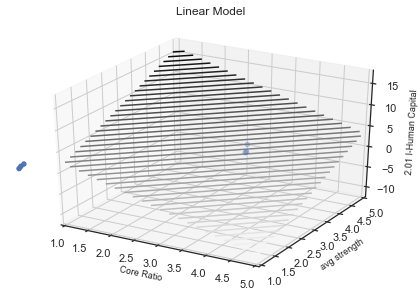




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8698976249461958, p-value: [[0.00360398 0.00890067]]
Regression Coefficients: [ 2.4814277  -1.41363464]
Intercept: 1.7139866282678027


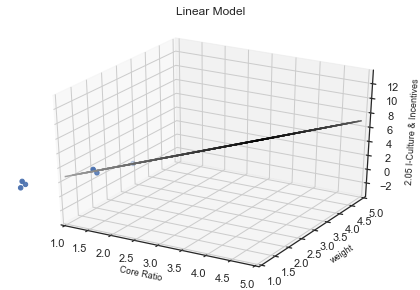




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9144273884090999, p-value: [[0.00206144 0.00360418]]
Regression Coefficients: [ 0.90883162 -0.54212394]
Intercept: 1.9617928748358666


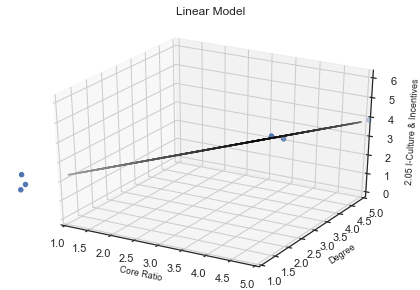




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.893207129032826, p-value: [[0.00362228 0.00581026]]
Regression Coefficients: [ 0.24371356 -0.15431255]
Intercept: 2.0551739803120217


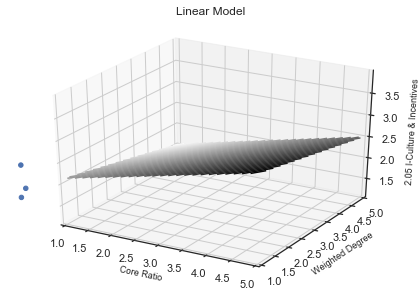




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8011344945245285, p-value: [[0.02937236 0.01668553]]
Regression Coefficients: [ 0.05334684 -0.04587152]
Intercept: 3.271912700177281


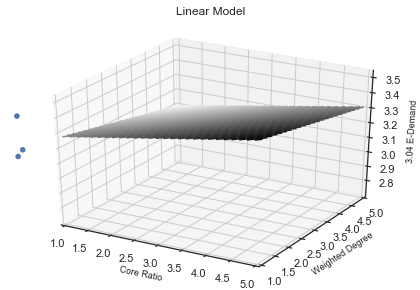




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Eccentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8046756356182931, p-value: [[0.02944266 0.01628661]]
Regression Coefficients: [-0.59859654  0.7413035 ]
Intercept: 1.987772287793379


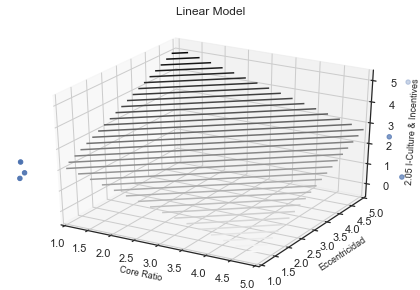




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Clustering
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8765299266607446, p-value: [[0.02856049 0.00815793]]
Regression Coefficients: [ 3.08919993 -3.81914547]
Intercept: 2.0507274587825397


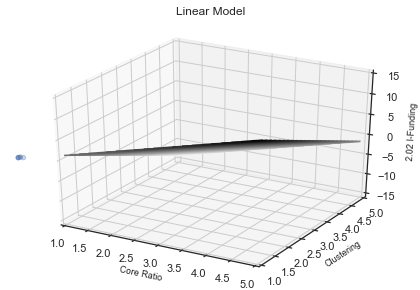




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8054678471927108, p-value: [[0.02500874 0.01521007]]
Regression Coefficients: [-0.51823936  0.63129799]
Intercept: 2.0142389613000065


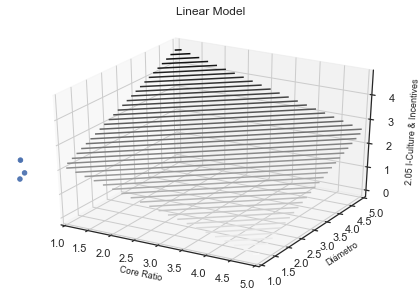




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8424059166702831, p-value: [[0.01682593 0.00784269]]
Regression Coefficients: [-0.68464504  1.03205423]
Intercept: 1.8907218141021862


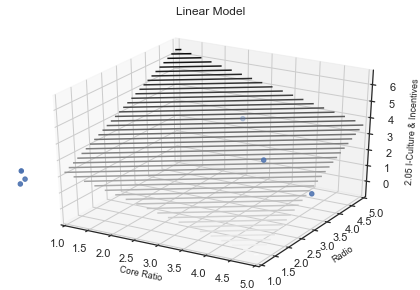




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Transitividad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9398300953212213, p-value: [[0.0082286 0.0016996]]
Regression Coefficients: [ 2.46446739 -3.19344335]
Intercept: 2.0140173965647423


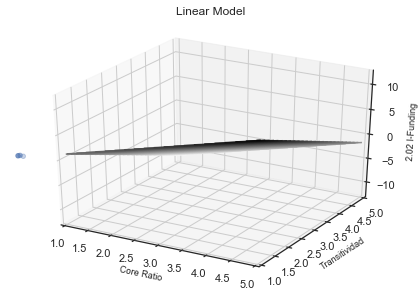




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Eficiencia Global
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.868645200856928, p-value: [[0.04536282 0.01068911]]
Regression Coefficients: [ 2.29820406 -3.23411751]
Intercept: 2.0973175285701533


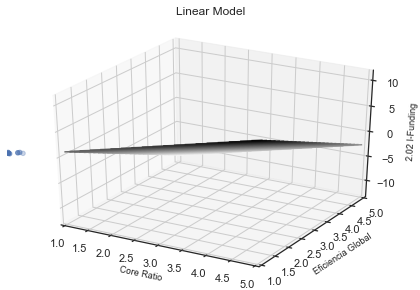




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Small Worldness
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8458739086277026, p-value: [[0.01142921 0.02116757]]
Regression Coefficients: [-2.71639919  1.83391482]
Intercept: 3.5407990817012864


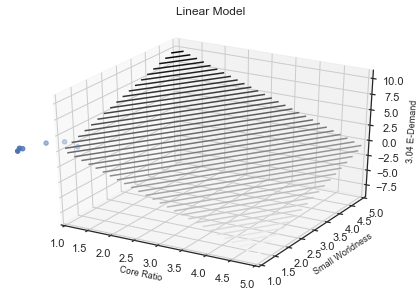




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8135379493050547, p-value: [[0.01269386 0.01277257]]
Regression Coefficients: [-2.10031001  2.10910577]
Intercept: 2.7345476986196826


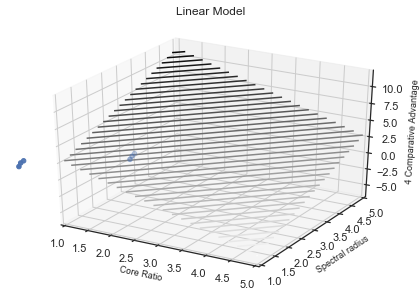




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8464259386201015, p-value: [[0.00813445 0.00957317]]
Regression Coefficients: [-1.21963189  1.22680084]
Intercept: 3.0256259018385103


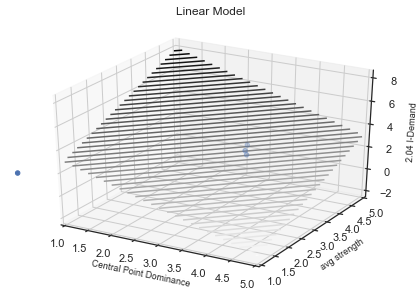




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9777007921848511, p-value: [[0.00015408 0.00016136]]
Regression Coefficients: [-1.59147176  1.65753725]
Intercept: 2.1919270147561725


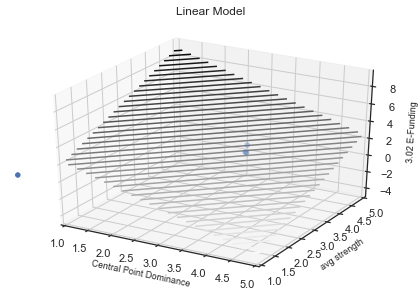




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8626318228344579, p-value: [[0.00527287 0.00924093]]
Regression Coefficients: [ 0.88402947 -0.52374772]
Intercept: 1.9470956518962725


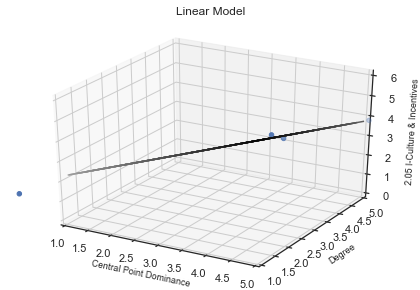




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8817966152976994, p-value: [[0.00441032 0.00711866]]
Regression Coefficients: [ 0.24279033 -0.15326688]
Intercept: 2.0467681601248913


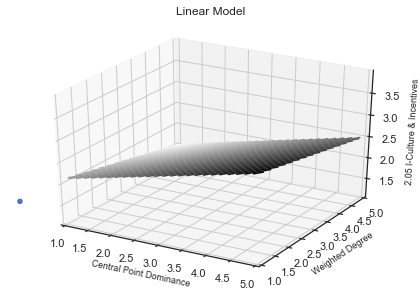




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Eccentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8283564494007906, p-value: [[0.02051673 0.01282278]]
Regression Coefficients: [-0.62548003  0.74388781]
Intercept: 2.1224920996652203


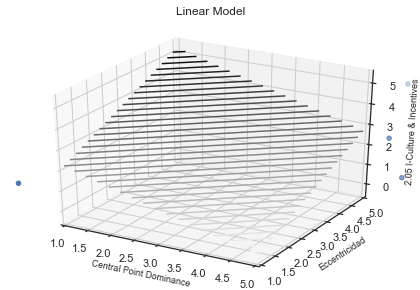




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8273011822510715, p-value: [[0.01849518 0.01235213]]
Regression Coefficients: [-0.53442338  0.63148747]
Intercept: 2.125633175017608


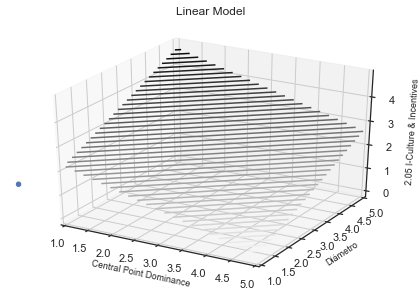




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8726601106448562, p-value: [[0.0099759  0.00593235]]
Regression Coefficients: [-0.71761078  1.00957228]
Intercept: 2.0984942156407103


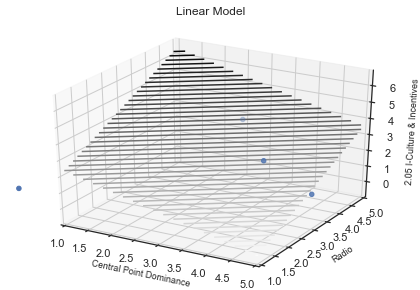




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9084725785109781, p-value: [[0.01190957 0.00125327]]
Regression Coefficients: [-1.12240246 -2.45045439]
Intercept: 3.784812226653128


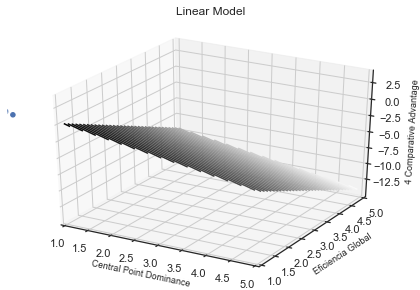




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8377042269116847, p-value: [[0.00789174 0.01082569]]
Regression Coefficients: [-1.39220418  1.30212097]
Intercept: 3.0572587204534196


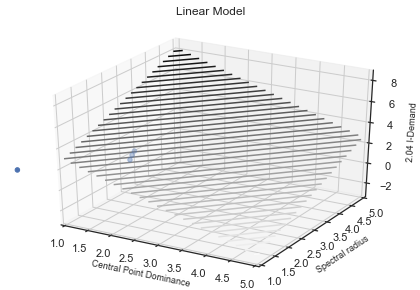




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9222052915808681, p-value: [[0.00170746 0.00192994]]
Regression Coefficients: [-1.75753756  1.74228666]
Intercept: 2.22246579097387


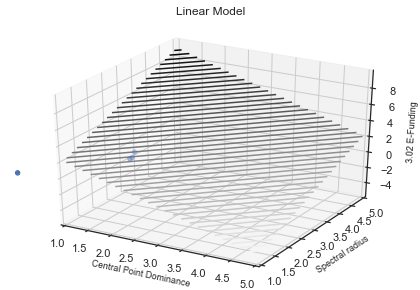




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8542644369416149, p-value: [[0.00887062 0.01446043]]
Regression Coefficients: [-1.40275378  1.24584577]
Intercept: 3.022969224509655


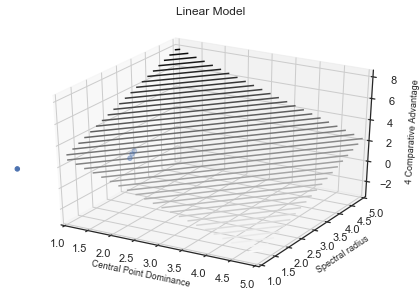




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, avg strength
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8096090277098883, p-value: [[0.03772738 0.02201432]]
Regression Coefficients: [-1.30254009  1.61510078]
Intercept: 0.9538407808398912


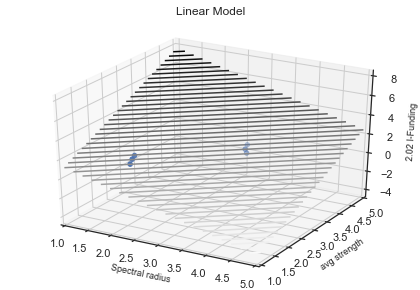




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9312417279924711, p-value: [[0.00029224 0.00202322]]
Regression Coefficients: [ 1.21848754 -0.53929732]
Intercept: 0.7722233575814594


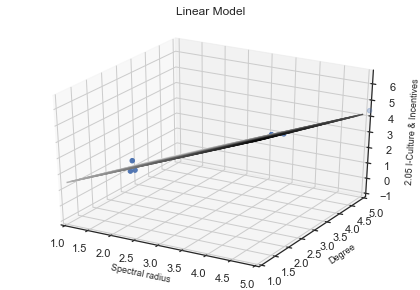




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8979642839826667, p-value: [[0.00266523 0.00530213]]
Regression Coefficients: [ 0.25654553 -0.15411633]
Intercept: 1.8831600236208088


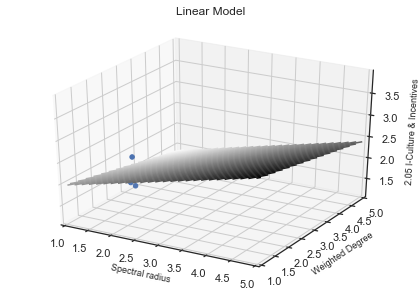




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8033451158064251, p-value: [[0.02602339 0.0161756 ]]
Regression Coefficients: [ 0.05465902 -0.04586472]
Intercept: 3.254265087130127


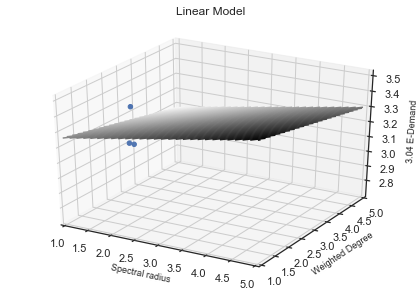




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8961301641393872, p-value: [[0.00411616 0.00426971]]
Regression Coefficients: [ 2.39158856 -2.39856982]
Intercept: 2.813015899522616


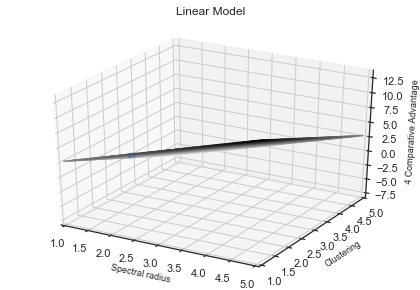




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9811364807385646, p-value: [[0.00012663 0.00013114]]
Regression Coefficients: [ 2.24307609 -2.2517247 ]
Intercept: 2.8211651634560453


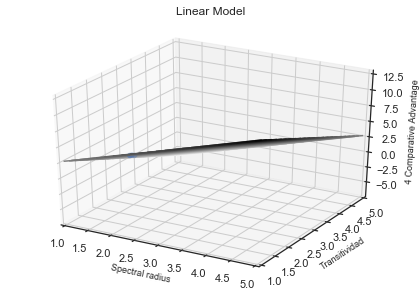




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9183428260073744, p-value: [[0.00343735 0.0039832 ]]
Regression Coefficients: [ 2.28940478 -2.22959398]
Intercept: 2.691286503544358


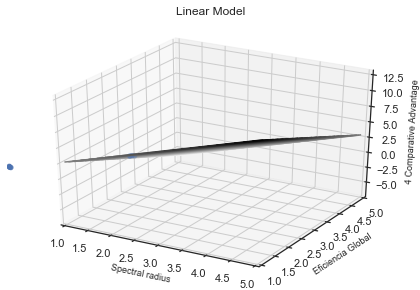




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Small Worldness
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.933359288709559, p-value: [[0.000308   0.00013628]]
Regression Coefficients: [-2.07273261  2.45284088]
Intercept: 0.8394904834965009


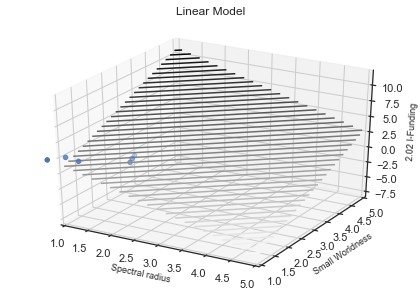




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9571068320668321, p-value: [[0.00058973 0.00058097]]
Regression Coefficients: [ 2.31630753 -2.33927   ]
Intercept: 2.8458457436856417


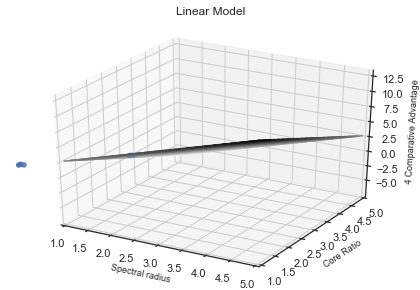




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9600502586401901, p-value: [[0.00041718 0.00050487]]
Regression Coefficients: [ 3.00061052 -2.92550501]
Intercept: 2.0677663096585994


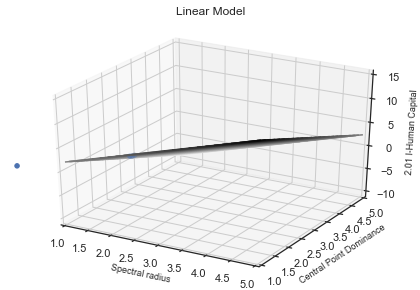




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8312381237796631, p-value: [[0.01108673 0.01081848]]
Regression Coefficients: [ 1.68058324 -1.73330093]
Intercept: 3.4869025321892995


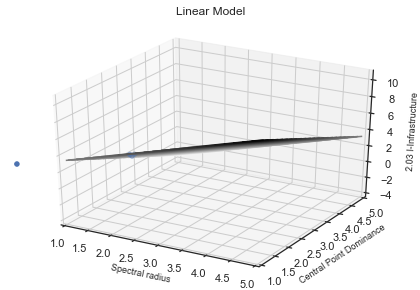




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8186469776800086, p-value: [[0.01398797 0.01324308]]
Regression Coefficients: [ 1.49369502 -1.55459211]
Intercept: 3.8492533755605156


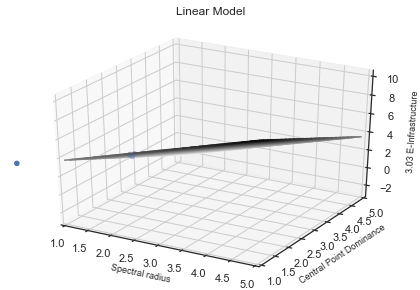

In [23]:
'''
3D linear models for predicting iEcosystem metrics using graph metrics
'''

grf_key_list=list(grf_df.keys())
grf_key_list.remove('Ciudad')
grf_key_list.remove('País')                                   # list of all global metrics

ieco_key_list=list(df_means.keys())
ieco_key_list.remove('Unnamed: 0')                            #iEco metrics predictors/to be predicted

for key1 in grf_key_list:
    for key2 in grf_key_list:                                 # for each pair (a,b) of distinct global metrics
        if key1 != key2:                                      
            for predict in ieco_key_list:               # and each predictor
                
                # we make a numpy array with the predicted values and reshape it into 2 rows, 6 columns
                X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = X.reshape(6,2)
                
                # make a numpy array for our predictor
                y=ieco_grf_df[predict].to_numpy()
                
                #make linear regression with X,y data and obtain p-value
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if p-value is small enough and the regression score is greater than 0.8:
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')
                